### Описание набора данных

| Column Name                            | Description                                               |
|----------------------------------------|-----------------------------------------------------------|
| FORCE_2020_LITHOFACIES_CONFIDENCE     | Qualitative measure of interpretation confidence          |
| FORCE_2020_LITHOFACIES_LITHOLOGY      | Interpreted Lithofacies                                   |
| RDEP                                   | Deep Reading Resistivity measurement                      |
| RSHA                                   | Shallow Reading Resistivity measurement                   |
| RMED                                   | Medium Deep Reading Resistivity measurement               |
| RXO                                    | Flushed Zone Resistivity measurement                      |
| RMIC                                   | Micro Resistivity measurement                             |
| SP                                     | Self Potential Log                                        |
| DTS                                    | Shear wave sonic log (us/ft)                              |
| DTC                                    | Compressional waves sonic log (us/ft)                     |
| NPHI                                   | Neutron Porosity log                                      |
| PEF                                    | Photo Electric Factor log                                 |
| GR                                     | Gamma Ray Log                                             |
| RHOB                                   | Bulk Density Log                                          |
| DRHO                                   | Density Correction log                                    |
| CALI                                   | Caliper log                                               |
| BS                                     | Borehole Size                                             |
| DCAL                                   | Differential Caliper log                                  |
| ROPA                                   | Average Rate of Penetration                               |
| SGR                                    | Spectra Gamma Ray log                                     |
| MUDWEIGHT                              | Weight of Drilling Mud                                    |
| ROP                                    | Rate of Penetration                                       |
| DEPTH_MD                               | Measured Depth                                            |
| x_loc                                  | X location of sample                                      |
| y_loc                                  | Y location of sample                                      |
| z_loc                                  | Z (TVDSS) Depth of sample                                 |


Данные содержат столбцы метаданных:
* WELL: название скважины
* DEPTH_MD: измеренная глубина
* X_LOC: UTM координата X
* Y_LOC: UTM координата Y
* Z_LOC: ГЛУБИНА
* GROUP: группа литостратиграфии NPD
* FORMATION: формация литостратиграфии NPD

Данные содержат кривые каротажа скважины. Например, следующие:
* BS: Размер бита
* CALI: Калипер
* RDEP: Глубокое сопротивление
* RHOB: Объемная плотность
* GR: Сырые данные гамма-излучения
* SGR: Спектральный гамма-излучение
* RMED: Среднее сопротивление
* ROP: Скорость бурения
* NPHI: Нейтронная пористость
* PEF: Фотоэлектрический коэффициент поглощения
* RSHA: Поверхностное сопротивление
* DTS: Звуковая скорость (поперечная)
* DTC: Звуковая скорость (компрессионная)

а также интерпретацию

* FORCE_2020_LITHOFACIES_LITHOLOGY: классификация литологии
* FORCE_2020_LITHOFACIES_CONFIDENCE: уверенность в интерпретации литологии (1: высокая, 2: средняя, 3: низкая)

### 1. Установка библиотек и загрузка данных

In [1]:
import joblib
import warnings
import matplotlib
import numpy as np
import pandas as pd
import seaborn as sns
import xgboost as xgb
from numpy import std
from numpy import mean
import lightgbm as lgbm
import plotly.express as px
import matplotlib.pyplot as plt
from xgboost import XGBClassifier
import matplotlib.colors as colors
from sklearn.metrics import f1_score
from pandas import DataFrame, Series
from scipy.ndimage import median_filter
from catboost import CatBoostClassifier
from sklearn.metrics import recall_score
from sklearn.impute import SimpleImputer
from sklearn.model_selection import KFold
from sklearn.metrics import jaccard_score
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import confusion_matrix
from matplotlib.colors import ListedColormap
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import LabelEncoder 
from sklearn.tree import DecisionTreeClassifier
from sklearn.preprocessing import OneHotEncoder
from sklearn.tree import plot_tree, export_text
from sklearn.preprocessing import OrdinalEncoder
from sklearn.linear_model import RidgeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import cross_val_score
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import fbeta_score, make_scorer
from mpl_toolkits.axes_grid1 import make_axes_locatable
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from sklearn.model_selection import RandomizedSearchCV, GridSearchCV
from sklearn.metrics import classification_report
import missingno as msno

sns.set_style('darkgrid')
matplotlib.rcParams['font.size'] = 14
matplotlib.rcParams['figure.figsize'] = (20, 16)
matplotlib.rcParams['figure.facecolor'] = '#00000000'

In [2]:
warnings.filterwarnings('ignore')
warnings.simplefilter('ignore')

In [298]:
df = pd.read_csv('../data/Vovle/CSV_train.csv', sep=';')

In [299]:
df.head()

,WELL,DEPTH_MD,X_LOC,Y_LOC,Z_LOC,GROUP,FORMATION,CALI,RSHA,RMED,...,ROP,DTS,DCAL,DRHO,MUDWEIGHT,RMIC,ROPA,RXO,FORCE_2020_LITHOFACIES_LITHOLOGY,FORCE_2020_LITHOFACIES_CONFIDENCE
0,15/9-13,494.528,437641.96875,6470972.5,-469.501831,NORDLAND GP.,NaN,19.480835,NaN,1.611410,...,34.636410,NaN,NaN,-0.574928,NaN,NaN,NaN,NaN,65000,1.0
1,15/9-13,494.680,437641.96875,6470972.5,-469.653809,NORDLAND GP.,NaN,19.468800,NaN,1.618070,...,34.636410,NaN,NaN,-0.570188,NaN,NaN,NaN,NaN,65000,1.0
2,15/9-13,494.832,437641.96875,6470972.5,-469.805786,NORDLAND GP.,NaN,19.468800,NaN,1.626459,...,34.779556,NaN,NaN,-0.574245,NaN,NaN,NaN,NaN,65000,1.0
3,15/9-13,494.984,437641.96875,6470972.5,-469.957794,NORDLAND GP.,NaN,19.459282,NaN,1.621594,...,39.965164,NaN,NaN,-0.586315,NaN,NaN,NaN,NaN,65000,1.0
4,15/9-13,495.136,437641.96875,6470972.5,-470.109772,NORDLAND GP.,NaN,19.453100,NaN,1.602679,...,57.483765,NaN,NaN,-0.597914,NaN,NaN,NaN,NaN,65000,1.0


In [247]:
columns_rows = df.shape

In [248]:
print('Количество столбцов {:}'.format(columns_rows[1]), 'Количество строк {:}'.format(columns_rows[0]))

Количество столбцов 29 Количество строк 1170511


### 2. EDA

Просмотр количества значений и типов столбцов

In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1170511 entries, 0 to 1170510
Data columns (total 29 columns):
 #   Column                             Non-Null Count    Dtype  
---  ------                             --------------    -----  
 0   WELL                               1170511 non-null  object 
 1   DEPTH_MD                           1170511 non-null  float64
 2   X_LOC                              1159736 non-null  float64
 3   Y_LOC                              1159736 non-null  float64
 4   Z_LOC                              1159736 non-null  float64
 5   GROUP                              1169233 non-null  object 
 6   FORMATION                          1033517 non-null  object 
 7   CALI                               1082634 non-null  float64
 8   RSHA                               630650 non-null   float64
 9   RMED                               1131518 non-null  float64
 10  RDEP                               1159496 non-null  float64
 11  RHOB                    

Описательная статистика численных столбцов

In [8]:
df.describe()

,DEPTH_MD,X_LOC,Y_LOC,Z_LOC,CALI,RSHA,RMED,RDEP,RHOB,GR,...,ROP,DTS,DCAL,DRHO,MUDWEIGHT,RMIC,ROPA,RXO,FORCE_2020_LITHOFACIES_LITHOLOGY,FORCE_2020_LITHOFACIES_CONFIDENCE
count,1.170511e+06,1.159736e+06,1.159736e+06,1.159736e+06,1.082634e+06,630650.000000,1.131518e+06,1.159496e+06,1.009242e+06,1.170511e+06,...,535071.000000,174613.000000,298833.000000,987857.000000,316151.000000,176160.000000,192325.000000,327427.000000,1.170511e+06,1.170332e+06
mean,2.184087e+03,4.856310e+05,6.681276e+06,-2.138527e+03,1.318568e+01,10.694664,4.986978e+00,1.069103e+01,2.284987e+00,7.091370e+01,...,137.367965,204.655019,1.223849,0.012196,1.216329,7.796809,23.505069,-95.779496,6.138598e+04,1.164258e+00
std,9.971821e+02,3.455641e+04,1.281524e+05,9.709426e+02,3.798907e+00,100.642597,5.467269e+01,1.139480e+02,2.532835e-01,3.423149e+01,...,1539.383558,71.068461,54.372859,7.477798,10.180834,89.741807,22.632800,348.980030,1.389170e+04,4.451180e-01
min,1.360860e+02,4.268988e+05,6.406641e+06,-5.395563e+03,2.344000e+00,0.000100,-8.418695e-03,3.170056e-02,7.209712e-01,1.092843e-01,...,-0.117977,69.163177,-12.215459,-7429.338867,0.125818,0.056586,-999.250122,-999.900024,3.000000e+04,1.000000e+00
25%,1.418597e+03,4.547996e+05,6.591327e+06,-2.811502e+03,9.429712e+00,0.854120,9.140862e-01,9.102396e-01,2.092203e+00,4.762722e+01,...,5.628000,155.936707,0.148438,-0.009253,0.143792,0.891272,11.281895,0.687681,6.500000e+04,1.000000e+00
50%,2.076605e+03,4.769203e+05,6.737311e+06,-2.042785e+03,1.255575e+01,1.399020,1.443584e+00,1.439000e+00,2.321228e+00,6.836763e+01,...,17.799999,188.200653,0.557320,0.001752,0.155774,1.967156,20.131153,1.366672,6.500000e+04,1.000000e+00
75%,2.864393e+03,5.201532e+05,6.784886e+06,-1.391866e+03,1.671075e+01,3.099348,2.680930e+00,2.557220e+00,2.488580e+00,8.903551e+01,...,34.812794,224.645081,1.299655,0.021702,1.168307,5.084564,31.138481,3.420790,6.500000e+04,1.000000e+00
max,5.436632e+03,5.726328e+05,6.856661e+06,-1.110860e+02,2.827900e+01,2193.904541,1.988616e+03,1.999887e+03,3.457820e+00,1.076964e+03,...,47015.125000,676.578125,10011.422852,2.836938,185.730927,10000.000000,742.797852,35930.671875,9.900000e+04,3.000000e+00


Расположение скважин

In [9]:
well_names_uniq = df.WELL.unique()
X_cor = df.groupby(['WELL'])['X_LOC'].mean()  
Y_cor = df.groupby(['WELL'])['Y_LOC'].mean()
data_count = df.groupby(['WELL']).count().sum(axis='columns')

loc_wells_df = pd.DataFrame({'WELL':well_names_uniq, 'X_LOC': X_cor, 'Y_LOC': Y_cor, 'data_points': data_count})

In [10]:
xx = loc_wells_df.X_LOC
yy = loc_wells_df.Y_LOC
ss = loc_wells_df.data_points
ind = loc_wells_df.index

def mapPlot():
    fig, ax = plt.subplots(figsize=(18,10))

    sns.scatterplot(data=loc_wells_df, x=xx, y=yy, size=ss, alpha=.7,
                 palette=['red', 'blue', 'green'],sizes=(10, 300), ax=ax)

    ax.set_title('Well Distributions: circle size based on data availability', fontsize = '16')
    ax.set_xlabel('X_coordinate (UTM)', fontsize = '12')
    ax.set_ylabel('Y_coordinate (UTM)', fontsize = '12')

    for x,y,z in zip(xx,yy,ind):
        label_s = "{}".format(z)
        ax.annotate(label_s, (x,y),  textcoords="offset points", 
                 xytext=(0,10), ha='center', fontsize = '8') 

    ax.grid(True, color='0.6',axis='both', dashes=(5,2,1,2))

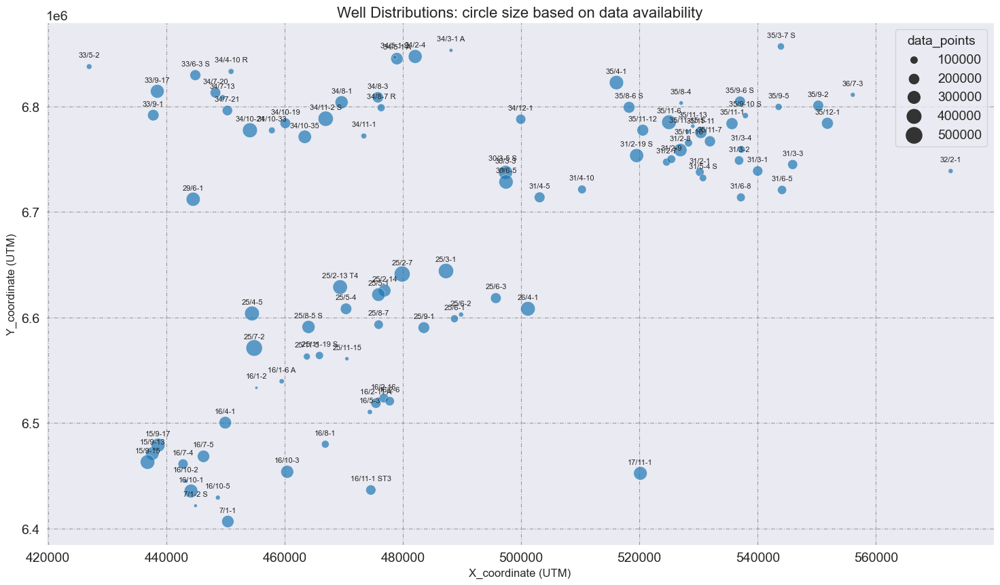

In [11]:
mapPlot()

#### 2.2 Визуализация каротажных кривых

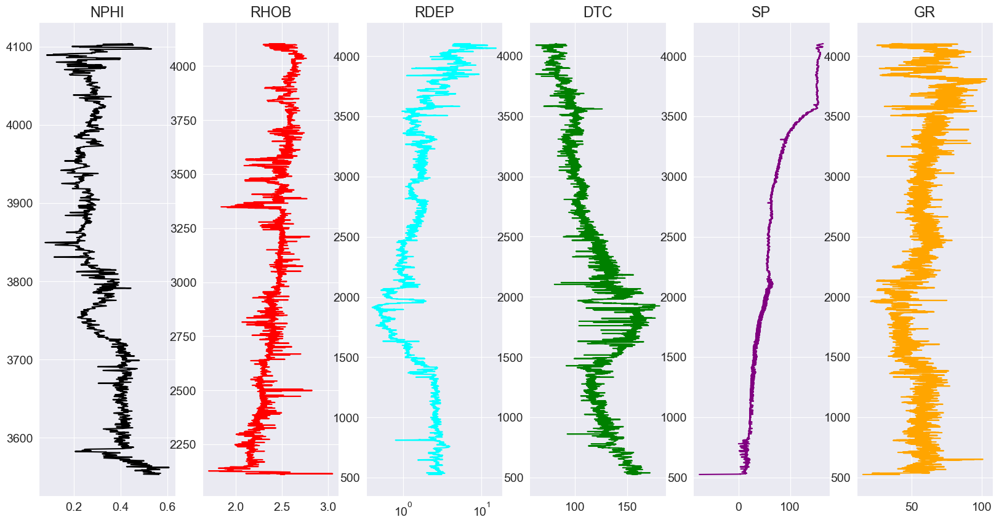

In [12]:
logs = ['NPHI', 'RHOB', 'RDEP', 'DTC', 'SP', 'GR']

fig, ax = plt.subplots(nrows=1, ncols=len(logs), figsize=(20,10))

colors = ['black', 'red', 'cyan', 'green', 'purple', 'orange', 'blue', 'yellow', 'magenta', 'brown', 'pink', 'lime']

for i in range(len(logs)):
    if i == 2:
        ax[i].semilogx(df.loc[df['WELL'] == '34/2-4'][logs[i]], df.loc[df['WELL'] == '34/2-4']['DEPTH_MD'], color=colors[i])
    else:
        ax[i].plot(df.loc[df['WELL'] == '34/2-4'][logs[i]], df.loc[df['WELL'] == '34/2-4']['DEPTH_MD'], color=colors[i])

    ax[i].set_title(logs[i])

plt.show()

### 2.3 Визуализации

Визуализируем количество записей о каждой горной породе

In [300]:
lithology_keys = {30000: 'Sandstone',
                 65030: 'Sandstone/Shale',
                 65000: 'Shale',
                 80000: 'Marl',
                 74000: 'Dolomite',
                 70000: 'Limestone',
                 70032: 'Chalk',
                 88000: 'Halite',
                 86000: 'Anhydrite',
                 99000: 'Tuff',
                 90000: 'Coal',
                 93000: 'Basement'}

df['FaciesLabels'] = df['FORCE_2020_LITHOFACIES_LITHOLOGY'].map(lithology_keys)

Распределение количества записей о каждой из пород

In [301]:
df['FaciesLabels'].value_counts()

Shale              720803
Sandstone          168937
Sandstone/Shale    150455
Limestone           56320
Marl                33329
Tuff                15245
Chalk               10513
Halite               8213
Coal                 3820
Dolomite             1688
Anhydrite            1085
Basement              103
Name: FaciesLabels, dtype: int64

In [302]:
{0: ('Sandstone', '#e6e208'),
 1: ('Sandstone/Shale', '#f2f21d'),
 2: ('Shale', '#0b8102'),
 3: ('Marl', '#bb4cd0'),
 4: ('Dolomite', '#f75f00'),
 5: ('Limestone', '#ff7f0e'),
 6: ('Chalk', '#1f77b4'),
 7: ('Halite', '#ff00ff'),
 8: ('Anhydrite', '#9467bd'),
 9: ('Tuff', '#d62728'),
 10: ('Coal', '#8c564b'),
 11: ('Basement', '#7f7f7f')}

{0: ('Sandstone', '#e6e208'),
 1: ('Sandstone/Shale', '#f2f21d'),
 2: ('Shale', '#0b8102'),
 3: ('Marl', '#bb4cd0'),
 4: ('Dolomite', '#f75f00'),
 5: ('Limestone', '#ff7f0e'),
 6: ('Chalk', '#1f77b4'),
 7: ('Halite', '#ff00ff'),
 8: ('Anhydrite', '#9467bd'),
 9: ('Tuff', '#d62728'),
 10: ('Coal', '#8c564b'),
 11: ('Basement', '#7f7f7f')}

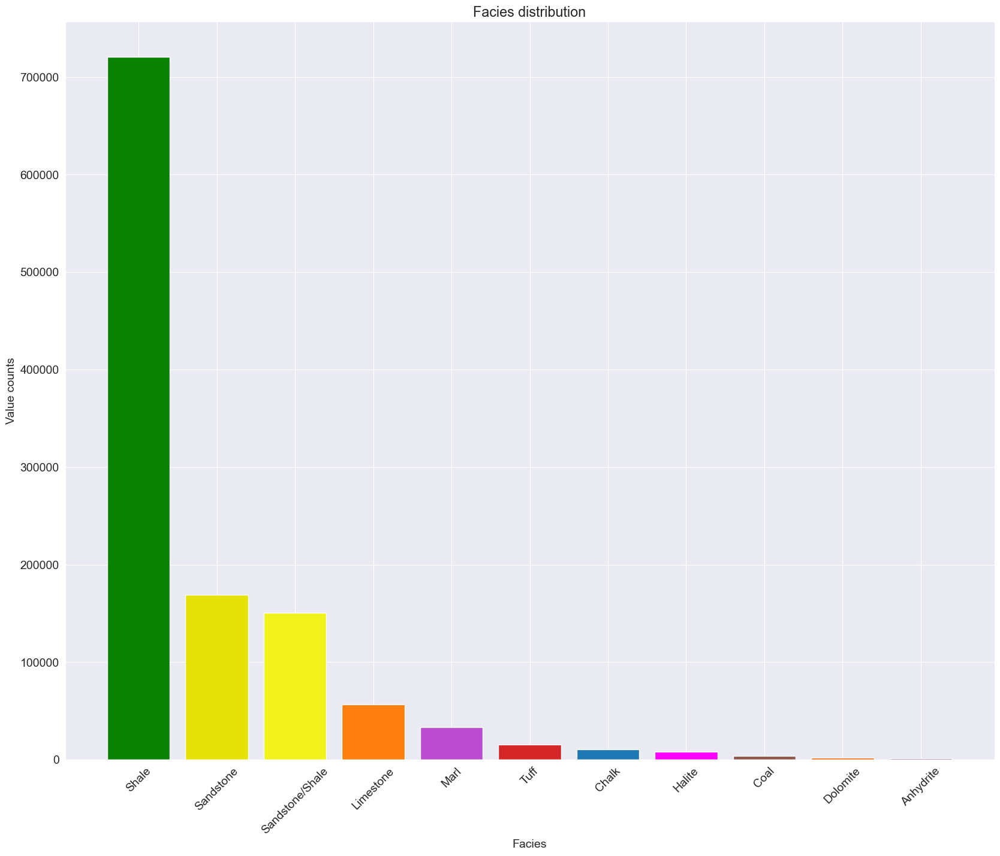

In [433]:
# Определение цветов для каждой фации
facies_colors = {'Sandstone': '#e6e208', 'Sandstone/Shale': '#f2f21d', 'Shale': '#0b8102',
                 'Marl': '#bb4cd0', 'Dolomite': '#f75f00', 'Limestone': '#ff7f0e',
                 'Chalk': '#1f77b4', 'Halite': '#ff00ff', 'Anhydrite': '#9467bd',
                 'Tuff': '#d62728', 'Coal': '#8c564b', 'Basement': '#7f7f7f'}

df = df[df['FaciesLabels'] != 'Basement']

facies_counts = df['FaciesLabels'].value_counts()

plt.bar(facies_counts.index, facies_counts.values, color=[facies_colors[f] for f in facies_counts.index])
plt.title('Facies distribution')
plt.xlabel('Facies')
plt.ylabel('Value counts')

plt.xticks(rotation=45) 

plt.show()

Выбор признаков для решения задачи классификации

In [16]:
numeric_columns = df.select_dtypes(include=['int64', 'float64']).columns

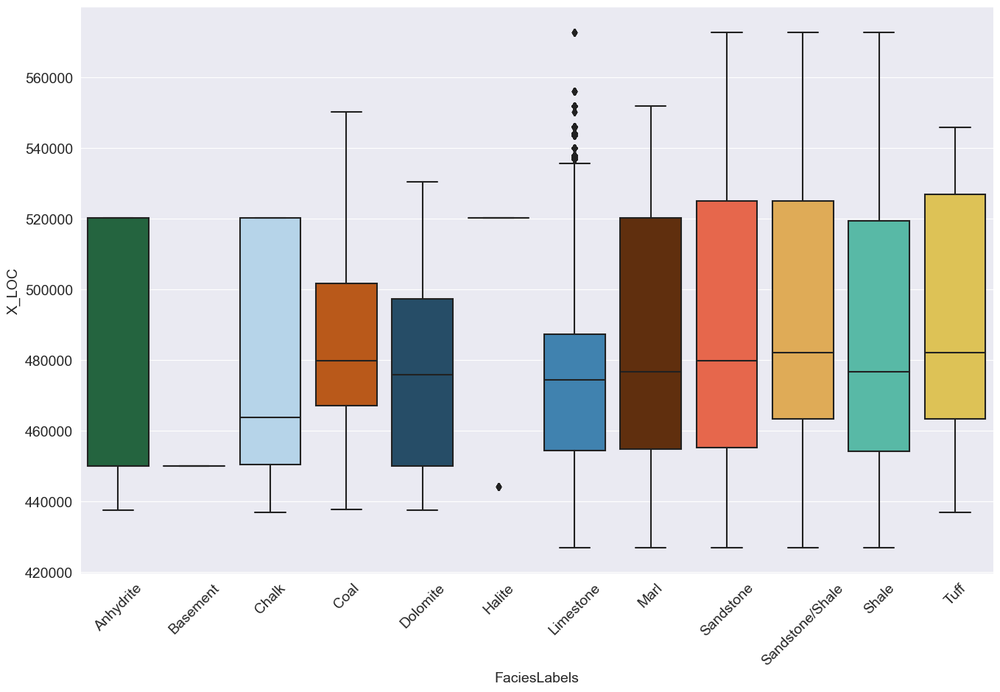

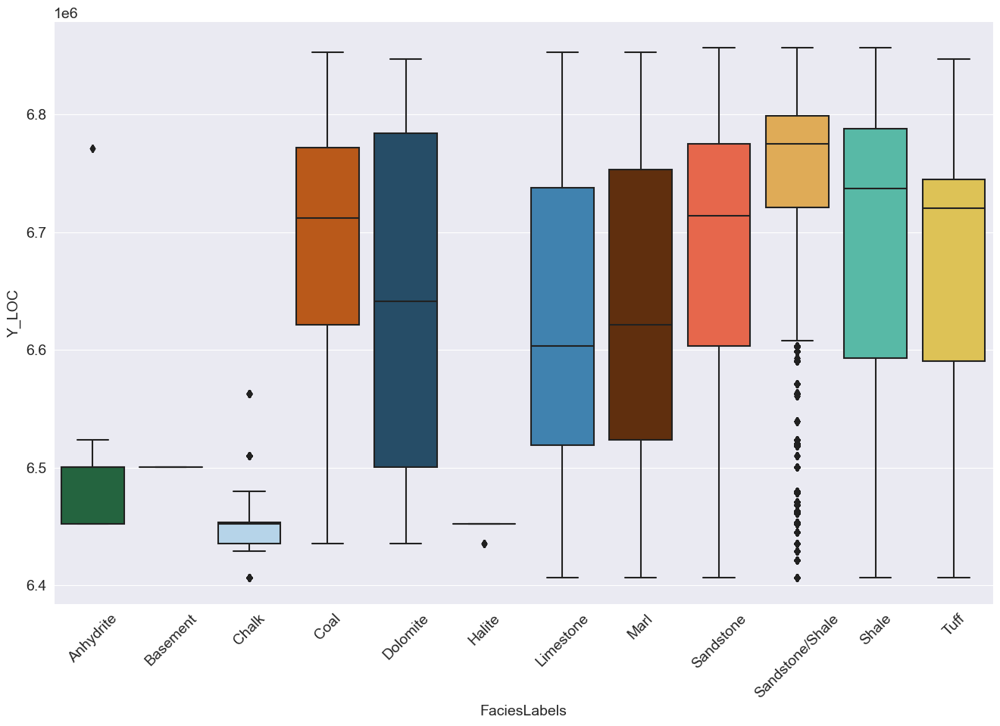

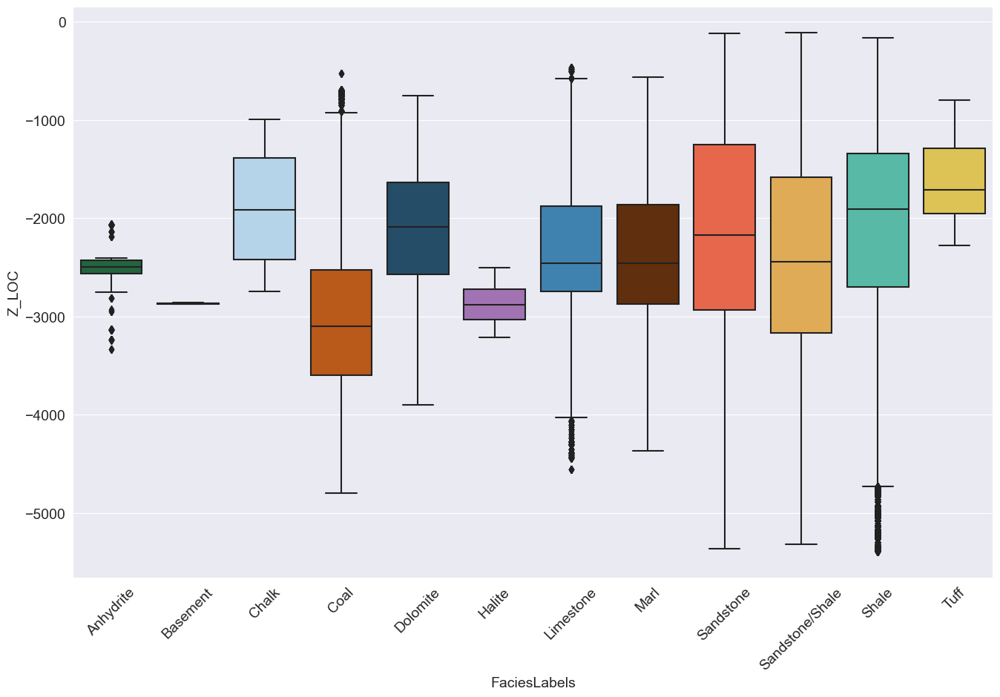

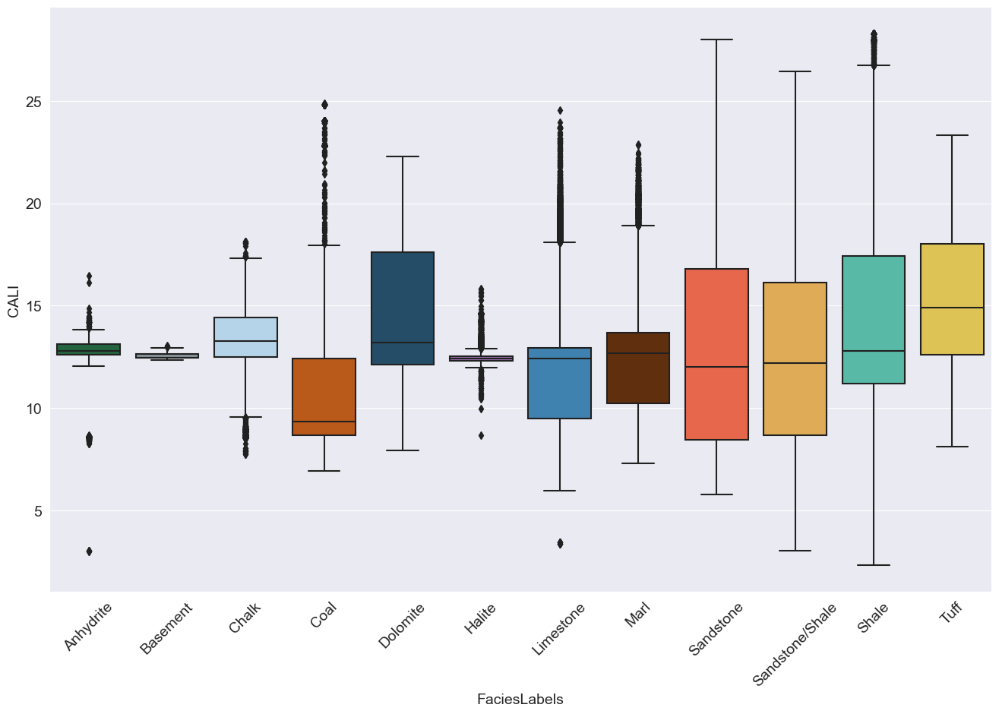

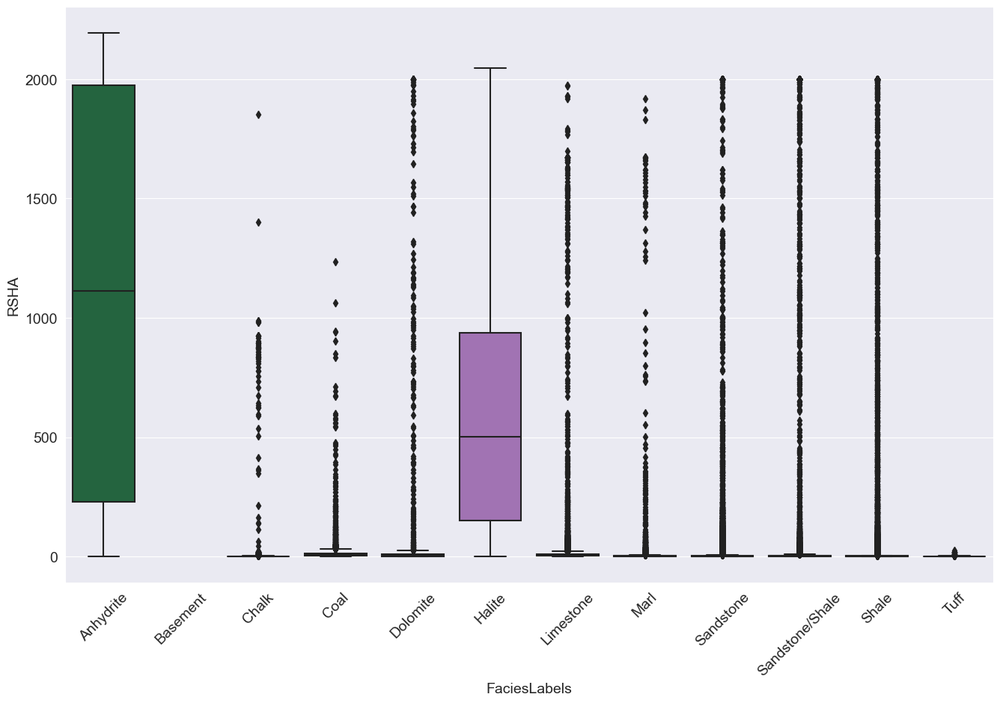

...

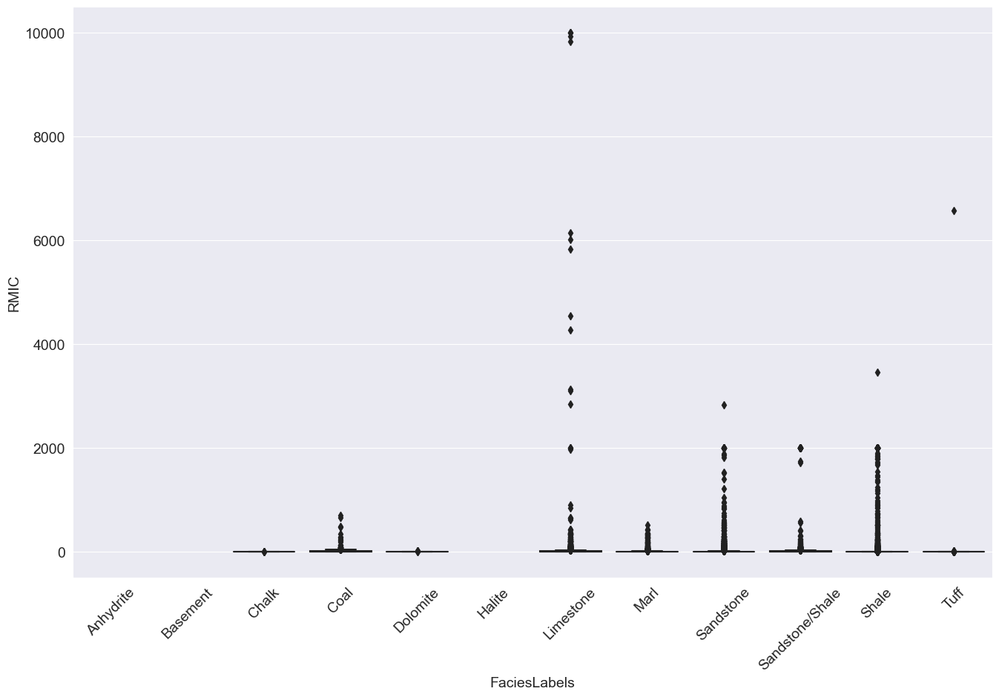

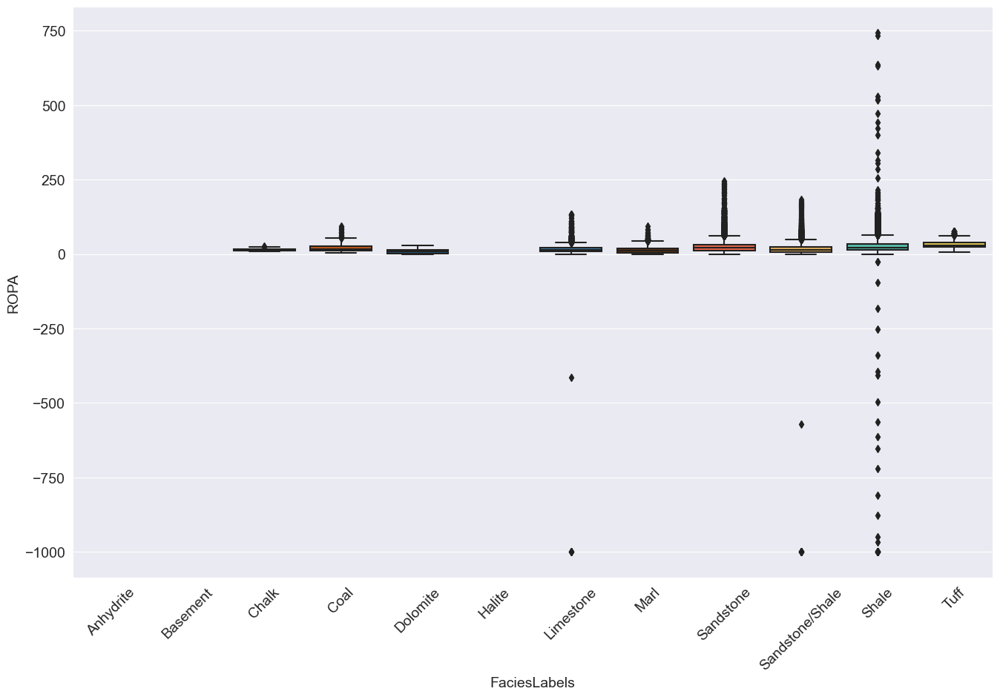

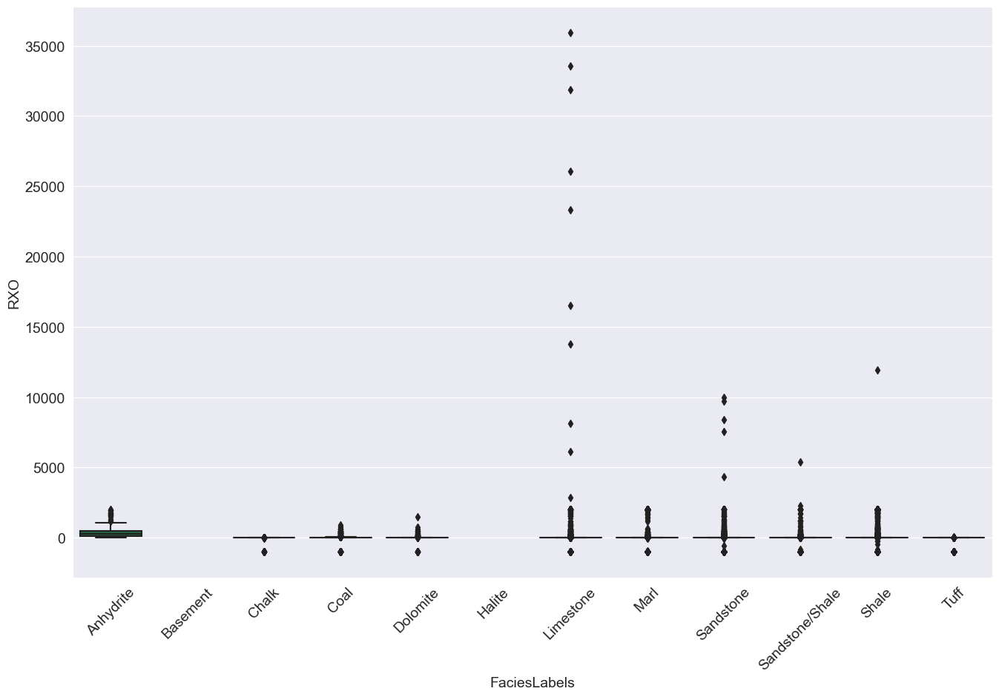

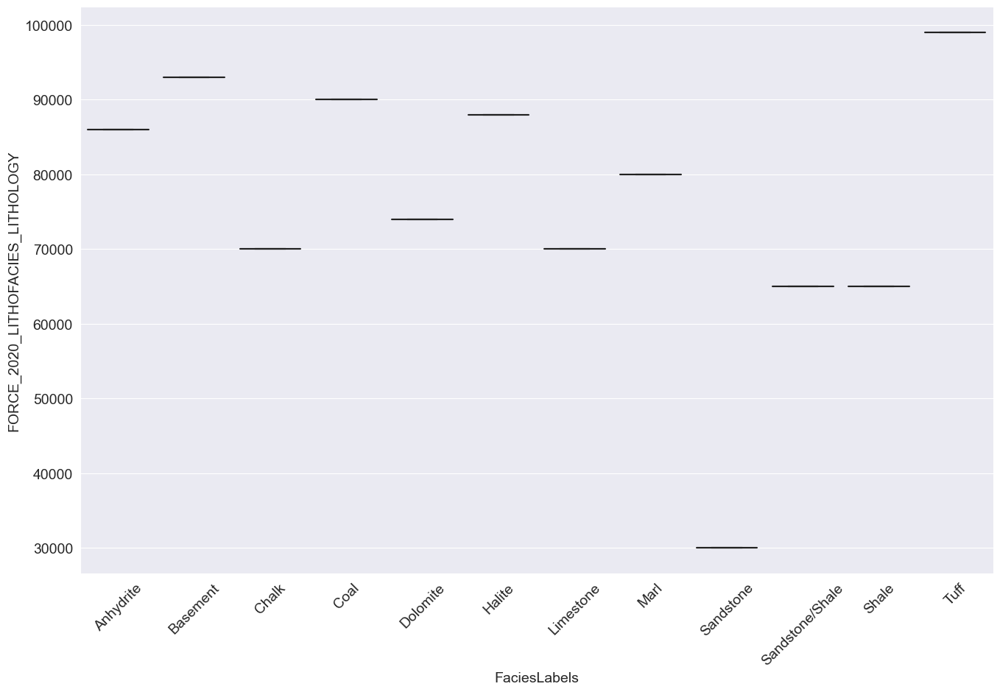

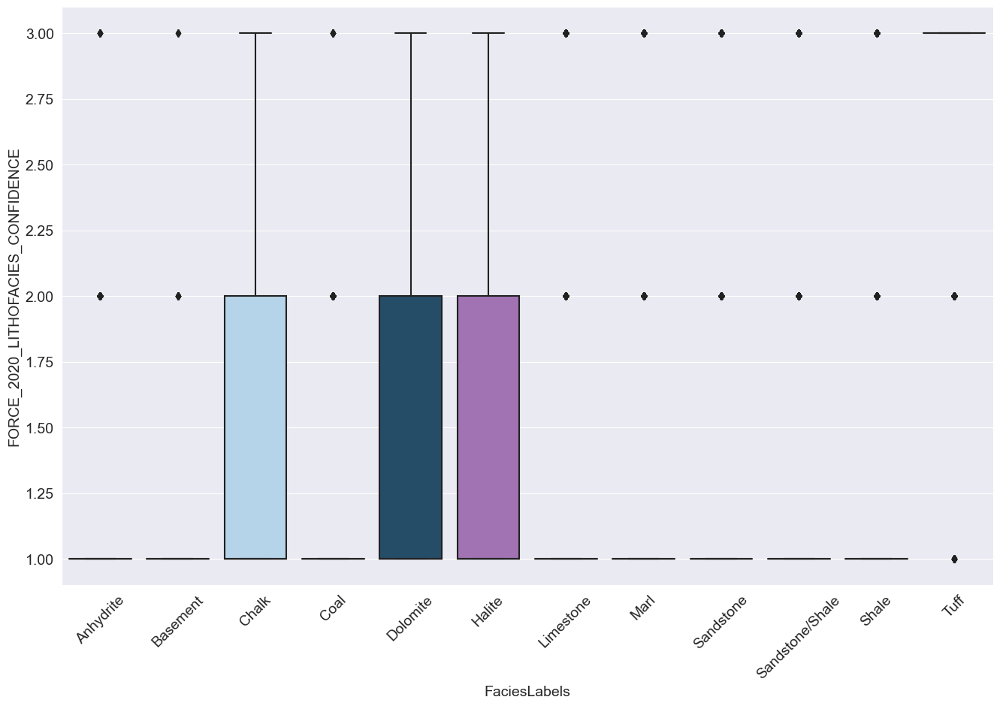

In [28]:
#Ящики с усами
for col in numeric_columns[1:]:
    if col != 'NM_M':
        fig = plt.figure()
        fig.set_size_inches(16, 10)
        sns.boxplot(y=col, x=df['FaciesLabels'].astype('category'), data=df, palette=facies_colors)
        plt.xticks(rotation=45)
        plt.show()

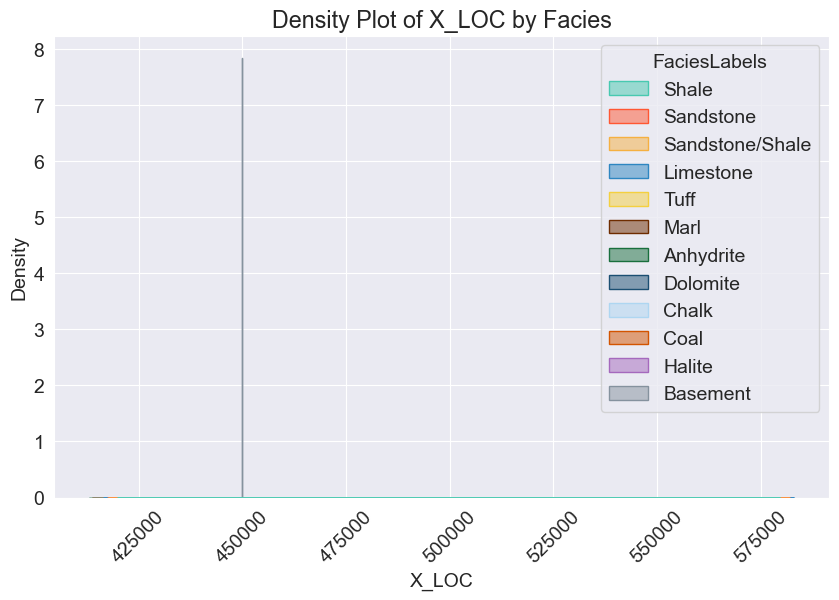

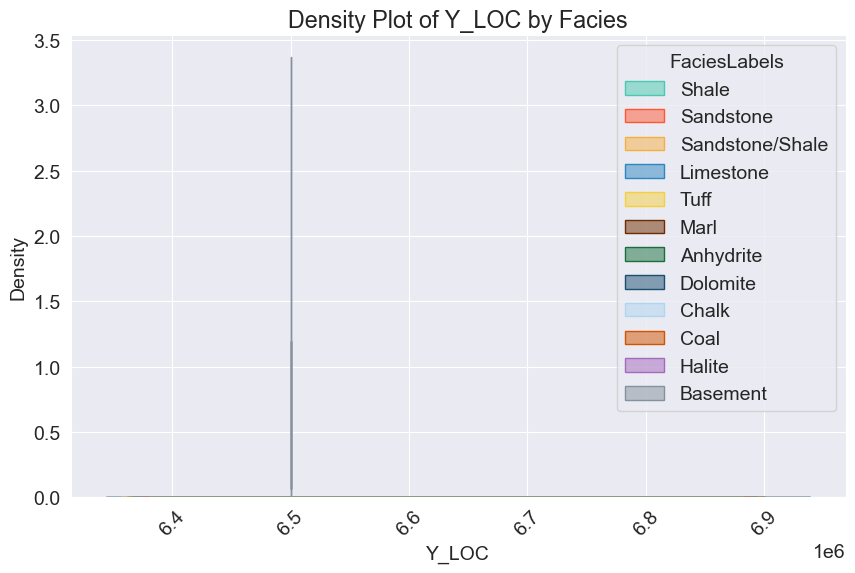

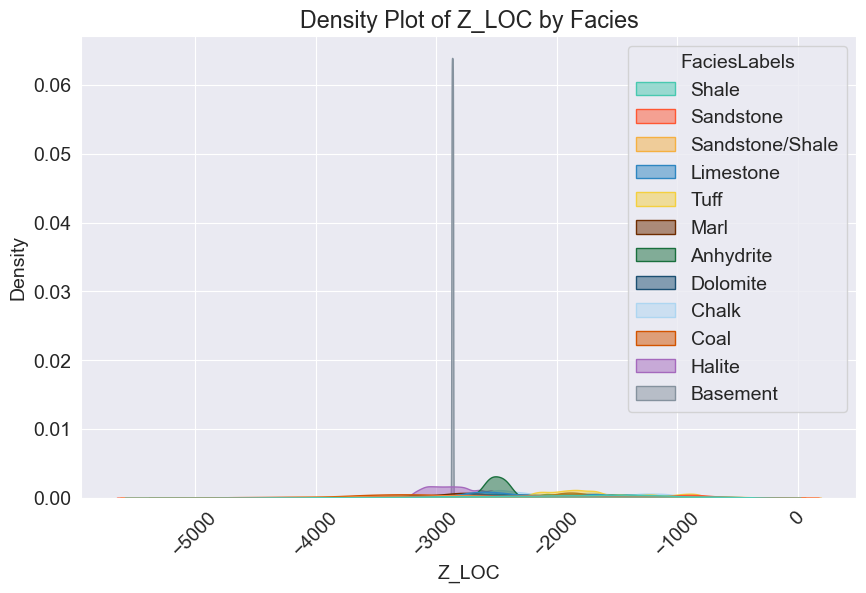

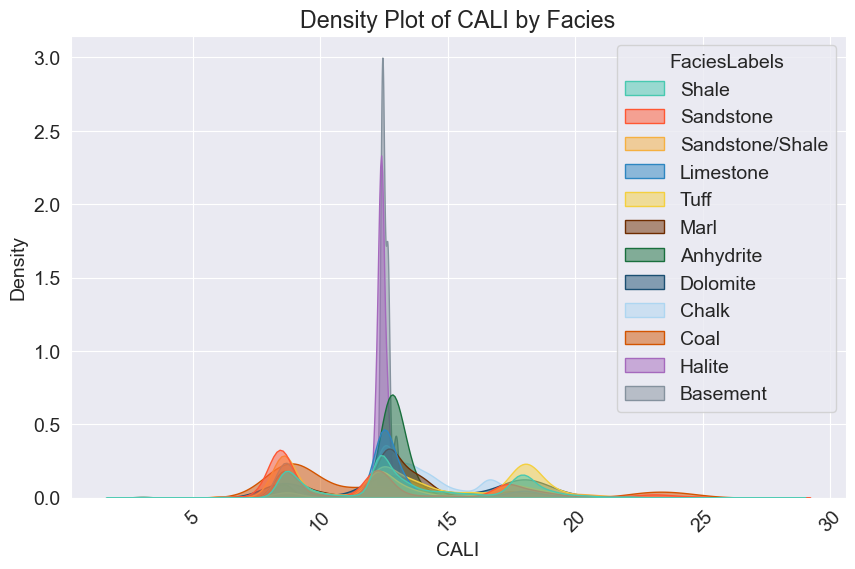

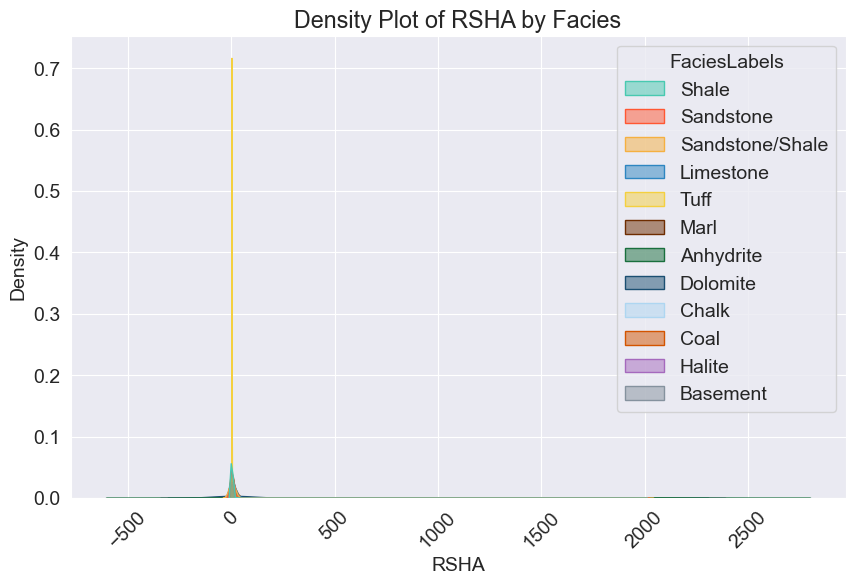

...

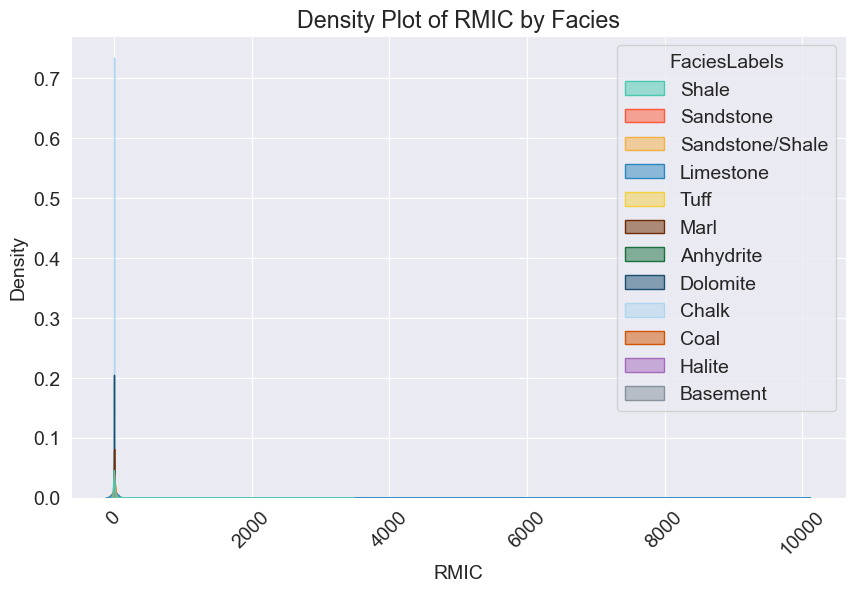

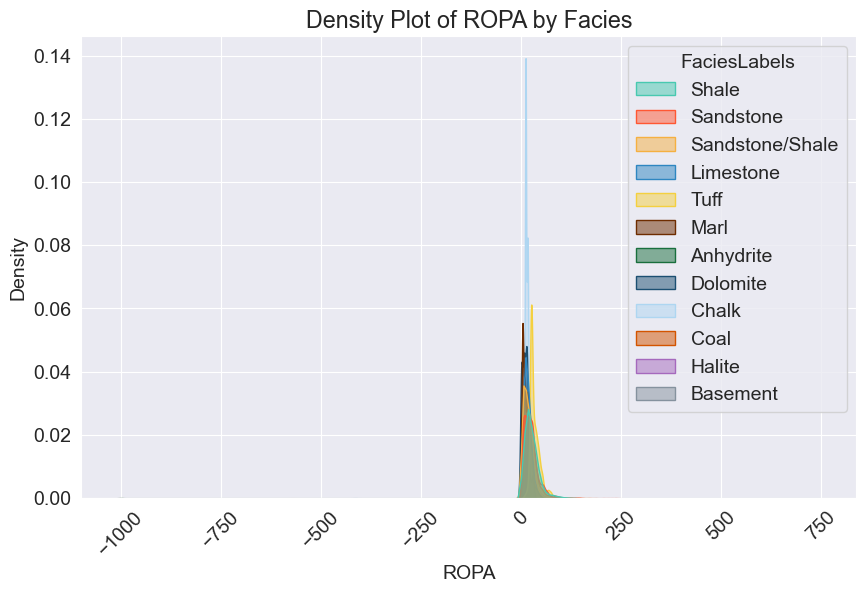

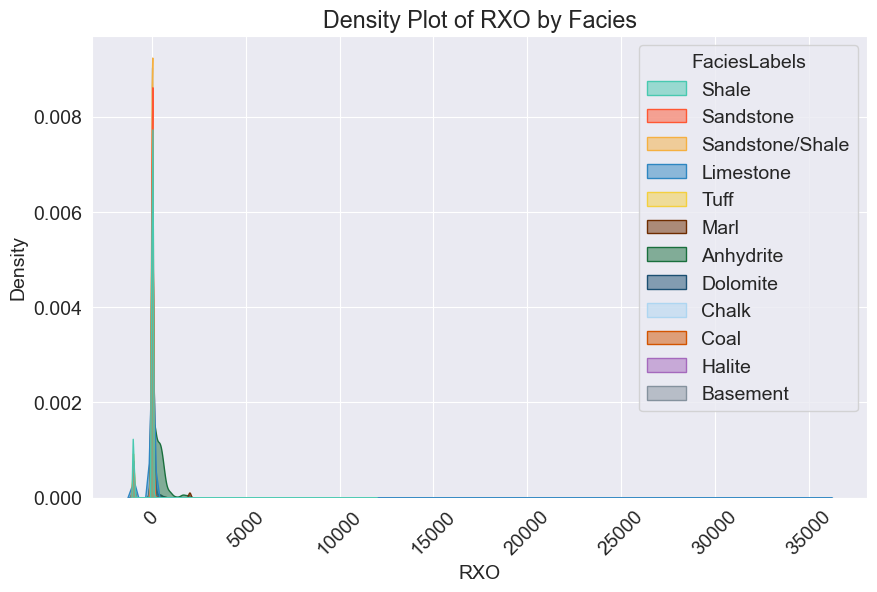

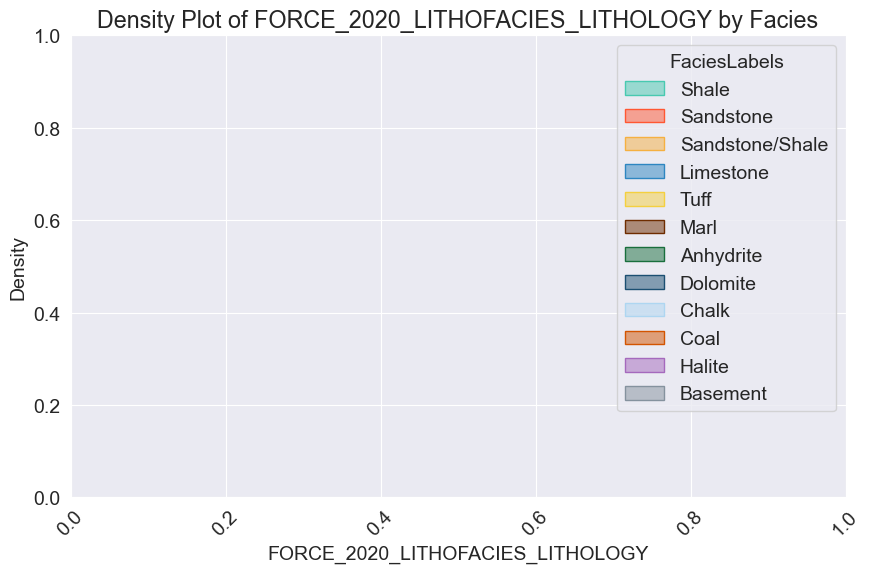

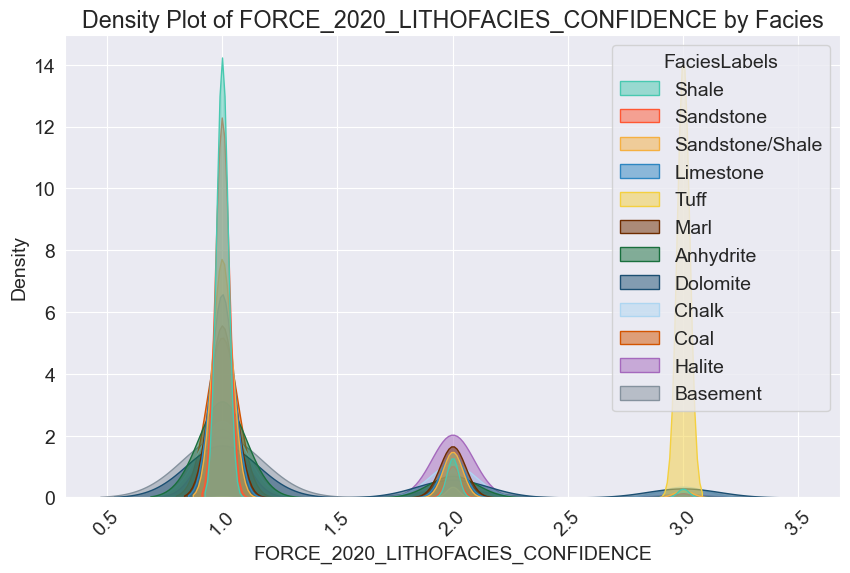

In [46]:
for col in numeric_columns[1:]:
    plt.figure(figsize=(10, 6))
    sns.kdeplot(data=df, x=col, hue='FaciesLabels', fill=True, common_norm=False, palette=facies_colors, alpha=0.5)
    plt.title(f'Density Plot of {col} by Facies')
    plt.xlabel(col)
    plt.ylabel('Density')
    #legend_labels = [facies_colors[color] for color in facies_colors.values()]
    # plt.legend(title='Facies', labels=legend_labels)
    #plt.legend(title='Facies')
    plt.xticks(rotation=45) 
    plt.show()

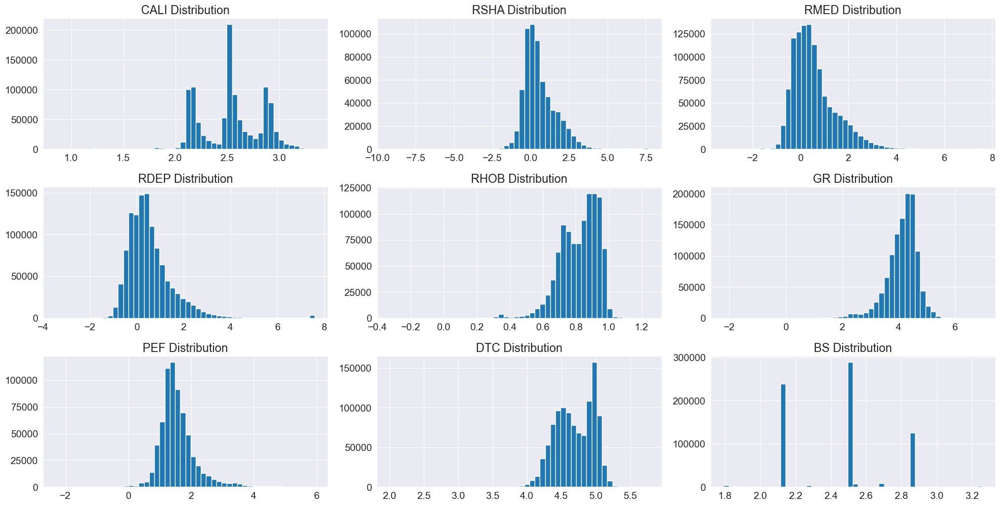

In [17]:
fig = plt.figure(figsize=(20, 20))
features = ['CALI', 'RSHA', 'RMED', 'RDEP', 'RHOB', 'GR', 'PEF', 'DTC', 'BS']

for i, feature in enumerate(features):
    ax = fig.add_subplot(6, 3, i + 1)
    try:
        np.log(df[feature]).hist(bins=50, ax=ax)
    except:
        pass
    ax.set_title(feature + " Distribution")

fig.tight_layout()  
plt.show()

Удаление выбросов

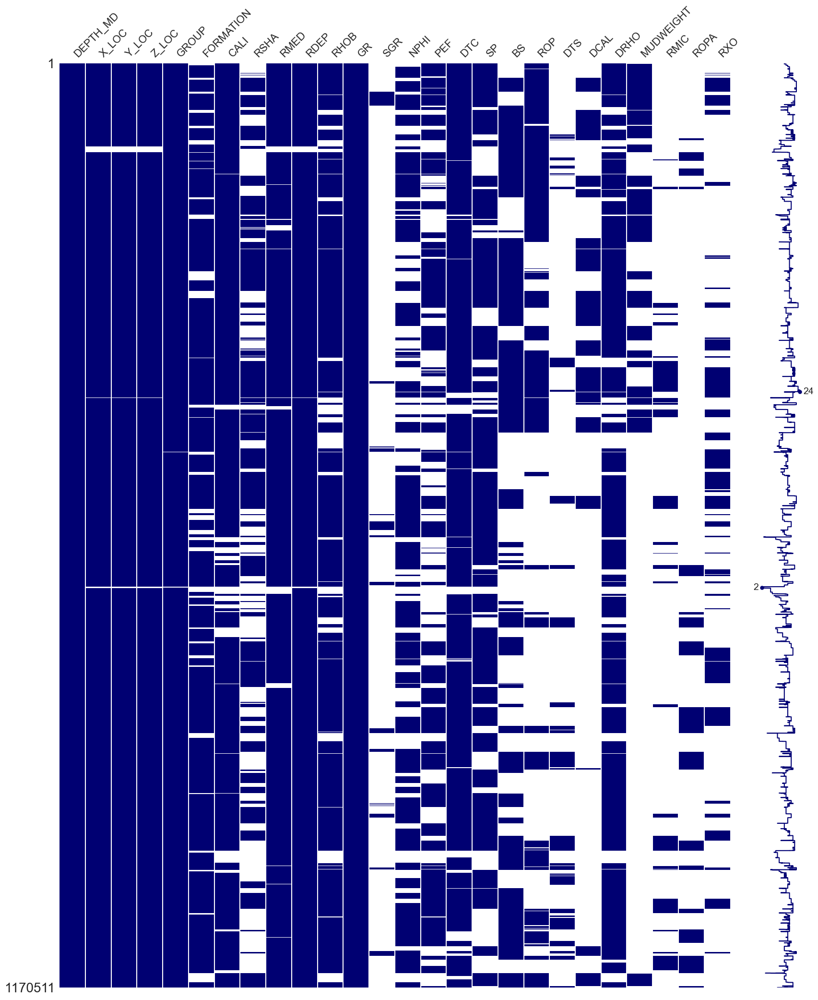

In [249]:
import missingno as msno

msno.matrix(df.drop(columns=['WELL', 'FORCE_2020_LITHOFACIES_LITHOLOGY', 'FORCE_2020_LITHOFACIES_CONFIDENCE']),
            color=(0., 0., 0.45))   
fig = plt.gcf()
fig.set_size_inches(20, 25)

In [304]:
features = ['DEPTH_MD', 'CALI', 'RSHA', 'RMED', 'RDEP', 'RHOB', 'GR', 'DTC', 'DRHO', 'NPHI']

Подсчет количества уникальных и пропущенных значений

In [305]:
dftype = pd.DataFrame(df.dtypes, columns=['Data_Type'])
dftype['Number_Unique'] = df.nunique()
dftype['Nan_bool'] = df.isna().any()
dftype['Number_of_Nan'] = df.isna().sum()
dftype

,Data_Type,Number_Unique,Nan_bool,Number_of_Nan
WELL,object,98,False,0
DEPTH_MD,float64,1146418,False,0
X_LOC,float64,166525,True,10775
Y_LOC,float64,17481,True,10775
Z_LOC,float64,1128126,True,10775
GROUP,object,14,True,1278
FORMATION,object,69,True,136994
CALI,float64,874208,True,87877
RSHA,float64,619225,True,539861
RMED,float64,1104594,True,38993


Замена пропущенных значений в численных колонках средним значением

In [306]:
df[numeric_columns] = df[numeric_columns].fillna(df[numeric_columns].mean())

In [307]:
df[numeric_columns].isna().sum()

DEPTH_MD                             0
X_LOC                                0
Y_LOC                                0
Z_LOC                                0
CALI                                 0
RSHA                                 0
RMED                                 0
RDEP                                 0
RHOB                                 0
GR                                   0
SGR                                  0
NPHI                                 0
PEF                                  0
DTC                                  0
SP                                   0
BS                                   0
ROP                                  0
DTS                                  0
DCAL                                 0
DRHO                                 0
MUDWEIGHT                            0
RMIC                                 0
ROPA                                 0
RXO                                  0
FORCE_2020_LITHOFACIES_LITHOLOGY     0
FORCE_2020_LITHOFACIES_CO

### 2.4 Нормализация данных

Выбор признаков, которые будут использоваться для классификации

In [308]:
df[features].head()

,DEPTH_MD,CALI,RSHA,RMED,RDEP,RHOB,GR,DTC,DRHO,NPHI
0,494.528,19.480835,10.694664,1.611410,1.798681,1.884186,80.200851,161.131180,-0.574928,0.331966
1,494.680,19.468800,10.694664,1.618070,1.795641,1.889794,79.262886,160.603470,-0.570188,0.331966
2,494.832,19.468800,10.694664,1.626459,1.800733,1.896523,74.821999,160.173615,-0.574245,0.331966
3,494.984,19.459282,10.694664,1.621594,1.801517,1.891913,72.878922,160.149429,-0.586315,0.331966
4,495.136,19.453100,10.694664,1.602679,1.795299,1.880034,71.729141,160.128342,-0.597914,0.331966


In [309]:
scaler = MinMaxScaler().fit(df[features])

In [310]:
import joblib

In [311]:
joblib.dump(scaler, 'scaler.pkl')

['scaler.pkl']

In [312]:
transformed_df = df

transformed_df[features] = scaler.transform(df[features])

In [313]:
transformed_df.describe()

,DEPTH_MD,X_LOC,Y_LOC,Z_LOC,CALI,RSHA,RMED,RDEP,RHOB,GR,...,ROP,DTS,DCAL,DRHO,MUDWEIGHT,RMIC,ROPA,RXO,FORCE_2020_LITHOFACIES_LITHOLOGY,FORCE_2020_LITHOFACIES_CONFIDENCE
count,1.170511e+06,1.170511e+06,1.170511e+06,1.170511e+06,1.170511e+06,1.170511e+06,1.170511e+06,1.170511e+06,1.170511e+06,1.170511e+06,...,1.170511e+06,1.170511e+06,1.170511e+06,1.170511e+06,1.170511e+06,1.170511e+06,1.170511e+06,1.170511e+06,1.170511e+06,1.170511e+06
mean,3.863755e-01,4.856310e+05,6.681276e+06,-2.138527e+03,4.180327e-01,4.874672e-03,2.511986e-03,5.330048e-03,5.714658e-01,6.575114e-02,...,1.373680e+02,2.046550e+02,1.223849e+00,9.996199e-01,1.216329e+00,7.796809e+00,2.350507e+01,-9.577950e+01,6.138598e+04,1.164258e+00
std,1.881282e-01,3.439699e+04,1.275612e+05,9.664633e+02,1.408723e-01,3.367212e-02,2.703090e-02,5.670939e-02,8.593419e-02,3.178840e-02,...,1.040794e+03,2.744899e+01,2.747313e+01,9.243086e-04,5.291056e+00,3.481446e+01,9.174184e+00,1.845736e+02,1.389170e+04,4.450840e-01
min,0.000000e+00,4.268988e+05,6.406641e+06,-5.395563e+03,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,...,-1.179770e-01,6.916318e+01,-1.221546e+01,0.000000e+00,1.258177e-01,5.658556e-02,-9.992501e+02,-9.999000e+02,3.000000e+04,1.000000e+00
25%,2.419582e-01,4.548019e+05,6.593126e+06,-2.804552e+03,2.906809e-01,5.907715e-04,4.713978e-04,4.416133e-04,5.123182e-01,4.412660e-02,...,2.061029e+01,2.046550e+02,1.223849e+00,9.996174e-01,1.216329e+00,7.796809e+00,2.350507e+01,-9.577950e+01,6.500000e+04,1.000000e+00
50%,3.660979e-01,4.777699e+05,6.732132e+06,-2.055283e+03,4.001156e-01,4.736759e-03,7.534114e-04,7.090959e-04,5.714658e-01,6.338678e-02,...,1.373680e+02,2.046550e+02,1.223849e+00,9.996192e-01,1.216329e+00,7.796809e+00,2.350507e+01,-9.577950e+01,6.500000e+04,1.000000e+00
75%,5.147218e-01,5.201314e+05,6.784877e+06,-1.397964e+03,5.168812e-01,4.874672e-03,1.525811e-03,1.292097e-03,6.365009e-01,8.257961e-02,...,1.373680e+02,2.046550e+02,1.223849e+00,9.996204e-01,1.216329e+00,7.796809e+00,2.350507e+01,1.201068e-01,6.500000e+04,1.000000e+00
max,1.000000e+00,5.726328e+05,6.856661e+06,-1.110860e+02,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,...,4.701512e+04,6.765781e+02,1.001142e+04,1.000000e+00,1.857309e+02,1.000000e+04,7.427979e+02,3.593067e+04,9.900000e+04,3.000000e+00


In [314]:
transformed_df

,WELL,DEPTH_MD,X_LOC,Y_LOC,Z_LOC,GROUP,FORMATION,CALI,RSHA,RMED,...,DTS,DCAL,DRHO,MUDWEIGHT,RMIC,ROPA,RXO,FORCE_2020_LITHOFACIES_LITHOLOGY,FORCE_2020_LITHOFACIES_CONFIDENCE,FaciesLabels
0,15/9-13,0.067624,437641.96875,6.470972e+06,-469.501831,NORDLAND GP.,NaN,0.660761,0.004875,0.000815,...,204.655019,1.223849,0.999541,1.216329,7.796809,23.505069,-95.779496,65000,1.0,Shale
1,15/9-13,0.067652,437641.96875,6.470972e+06,-469.653809,NORDLAND GP.,NaN,0.660297,0.004875,0.000818,...,204.655019,1.223849,0.999542,1.216329,7.796809,23.505069,-95.779496,65000,1.0,Shale
2,15/9-13,0.067681,437641.96875,6.470972e+06,-469.805786,NORDLAND GP.,NaN,0.660297,0.004875,0.000822,...,204.655019,1.223849,0.999541,1.216329,7.796809,23.505069,-95.779496,65000,1.0,Shale
3,15/9-13,0.067710,437641.96875,6.470972e+06,-469.957794,NORDLAND GP.,NaN,0.659930,0.004875,0.000820,...,204.655019,1.223849,0.999539,1.216329,7.796809,23.505069,-95.779496,65000,1.0,Shale
4,15/9-13,0.067738,437641.96875,6.470972e+06,-470.109772,NORDLAND GP.,NaN,0.659692,0.004875,0.000810,...,204.655019,1.223849,0.999538,1.216329,7.796809,23.505069,-95.779496,65000,1.0,Shale
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1170506,7/1-2 S,0.572248,485631.03274,6.681276e+06,-2138.527143,VESTLAND GP.,Bryne Fm.,0.234400,0.004875,0.002512,...,204.655019,1.223849,0.999618,1.216329,7.796809,26.673708,-95.779496,30000,2.0,Sandstone
1170507,7/1-2 S,0.572277,485631.03274,6.681276e+06,-2138.527143,VESTLAND GP.,Bryne Fm.,0.232707,0.004875,0.002512,...,204.655019,1.223849,0.999617,1.216329,7.796809,26.840818,-95.779496,65030,2.0,Sandstone/Shale
1170508,7/1-2 S,0.572305,485631.03274,6.681276e+06,-2138.527143,VESTLAND GP.,Bryne Fm.,0.231589,0.004875,0.002512,...,204.655019,1.223849,0.999616,1.216329,7.796809,27.007942,-95.779496,65030,2.0,Sandstone/Shale
1170509,7/1-2 S,0.572334,485631.03274,6.681276e+06,-2138.527143,VESTLAND GP.,Bryne Fm.,0.230182,0.004875,0.002512,...,204.655019,1.223849,0.999617,1.216329,7.796809,27.175179,-95.779496,65030,2.0,Sandstone/Shale


In [315]:
#Сохранение в файл 
selected_columns = features + ['FaciesLabels', 'FORCE_2020_LITHOFACIES_LITHOLOGY', 'WELL']

# Сохранение DataFrame в файл CSV
transformed_df[selected_columns].to_csv('../data/processed_data/transformed_data2.csv', 
                                        index=False)

## 3. Подготовка данных

In [261]:
transformed_df = pd.read_csv('../data/processed_data/transformed_data2.csv')

In [262]:
transformed_df

,DEPTH_MD,CALI,RSHA,RMED,RDEP,RHOB,GR,PEF,DTC,BS,NPHI,SP,FaciesLabels,FORCE_2020_LITHOFACIES_LITHOLOGY,WELL
0,0.067624,0.660761,0.004875,0.000815,0.000884,0.425020,0.074375,0.054345,0.491006,0.296572,0.355216,0.670980,Shale,65000,15/9-13
1,0.067652,0.660297,0.004875,0.000818,0.000882,0.427069,0.073504,0.050344,0.489320,0.296572,0.355216,0.670511,Shale,65000,15/9-13
2,0.067681,0.660297,0.004875,0.000822,0.000885,0.429527,0.069381,0.058721,0.487947,0.296572,0.355216,0.670524,Shale,65000,15/9-13
3,0.067710,0.659930,0.004875,0.000820,0.000885,0.427843,0.067576,0.083785,0.487870,0.296572,0.355216,0.670444,Shale,65000,15/9-13
4,0.067738,0.659692,0.004875,0.000810,0.000882,0.423503,0.066508,0.100243,0.487802,0.296572,0.355216,0.670647,Shale,65000,15/9-13
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1170506,0.572248,0.234400,0.004875,0.002512,0.005330,0.660253,0.072011,0.011714,0.338407,0.125000,0.355216,0.694199,Sandstone,30000,7/1-2 S
1170507,0.572277,0.232707,0.004875,0.002512,0.005330,0.663771,0.069884,0.018067,0.338407,0.125000,0.355216,0.694199,Sandstone/Shale,65030,7/1-2 S
1170508,0.572305,0.231589,0.004875,0.002512,0.005330,0.647054,0.061609,0.023366,0.338407,0.125000,0.355216,0.694199,Sandstone/Shale,65030,7/1-2 S
1170509,0.572334,0.230182,0.004875,0.002512,0.005330,0.630860,0.051702,0.022986,0.338407,0.125000,0.355216,0.694199,Sandstone/Shale,65030,7/1-2 S


In [316]:
transformed_df = transformed_df[transformed_df['FaciesLabels'] != 'Basement']

transformed_df['WELL'].value_counts().head()

25/2-7     25131
29/6-1     24464
25/7-2     23879
35/11-6    23544
34/2-4     23403
Name: WELL, dtype: int64

#### 3.1 Выбор тестовой части

In [317]:
transformed_df['WELL'].unique()

array(['15/9-13', '15/9-15', '15/9-17', '16/1-2', '16/1-6 A', '16/10-1',
       '16/10-2', '16/10-3', '16/10-5', '16/11-1 ST3', '16/2-11 A',
       '16/2-16', '16/2-6', '16/4-1', '16/5-3', '16/7-4', '16/7-5',
       '16/8-1', '17/11-1', '25/11-15', '25/11-19 S', '25/11-5',
       '25/2-13 T4', '25/2-14', '25/2-7', '25/3-1', '25/4-5', '25/5-1',
       '25/5-4', '25/6-1', '25/6-2', '25/6-3', '25/7-2', '25/8-5 S',
       '25/8-7', '25/9-1', '26/4-1', '29/6-1', '30/3-3', '30/3-5 S',
       '30/6-5', '31/2-1', '31/2-19 S', '31/2-7', '31/2-8', '31/2-9',
       '31/3-1', '31/3-2', '31/3-3', '31/3-4', '31/4-10', '31/4-5',
       '31/5-4 S', '31/6-5', '31/6-8', '32/2-1', '33/5-2', '33/6-3 S',
       '33/9-1', '33/9-17', '34/10-19', '34/10-21', '34/10-33',
       '34/10-35', '34/11-1', '34/11-2 S', '34/12-1', '34/2-4',
       '34/3-1 A', '34/4-10 R', '34/5-1 A', '34/5-1 S', '34/7-13',
       '34/7-20', '34/7-21', '34/8-1', '34/8-3', '34/8-7 R', '35/11-1',
       '35/11-10', '35/11-11', '35/11-12

Возьмем 12 последних скважин для валидации

In [318]:
all_wells = transformed_df['WELL'].unique().tolist()
test_wells = all_wells[:12]
    
# Определяем тренировочные скважины, исключая скважины из валидационного набора
training_wells = [well for well in all_wells if well not in test_wells]

In [319]:
print("Скважины из валидационного набора:", test_wells)

print("Скважины из тренировочного набора:", training_wells)

Скважины из валидационного набора: ['15/9-13', '15/9-15', '15/9-17', '16/1-2', '16/1-6 A', '16/10-1', '16/10-2', '16/10-3', '16/10-5', '16/11-1 ST3', '16/2-11 A', '16/2-16']
Скважины из тренировочного набора: ['16/2-6', '16/4-1', '16/5-3', '16/7-4', '16/7-5', '16/8-1', '17/11-1', '25/11-15', '25/11-19 S', '25/11-5', '25/2-13 T4', '25/2-14', '25/2-7', '25/3-1', '25/4-5', '25/5-1', '25/5-4', '25/6-1', '25/6-2', '25/6-3', '25/7-2', '25/8-5 S', '25/8-7', '25/9-1', '26/4-1', '29/6-1', '30/3-3', '30/3-5 S', '30/6-5', '31/2-1', '31/2-19 S', '31/2-7', '31/2-8', '31/2-9', '31/3-1', '31/3-2', '31/3-3', '31/3-4', '31/4-10', '31/4-5', '31/5-4 S', '31/6-5', '31/6-8', '32/2-1', '33/5-2', '33/6-3 S', '33/9-1', '33/9-17', '34/10-19', '34/10-21', '34/10-33', '34/10-35', '34/11-1', '34/11-2 S', '34/12-1', '34/2-4', '34/3-1 A', '34/4-10 R', '34/5-1 A', '34/5-1 S', '34/7-13', '34/7-20', '34/7-21', '34/8-1', '34/8-3', '34/8-7 R', '35/11-1', '35/11-10', '35/11-11', '35/11-12', '35/11-13', '35/11-15 S', '35/

In [320]:
# Выбираем строки для валидационного набора
test_data = transformed_df[transformed_df['WELL'].isin(test_wells)]

In [321]:
test_data['WELL'].value_counts()

15/9-13        18270
15/9-15        17717
16/10-1        17675
15/9-17        17350
16/10-3        15956
16/11-1 ST3    14938
16/2-11 A      10708
16/2-16        10025
16/1-6 A        3623
16/10-5         2765
16/10-2         2437
16/1-2          1734
Name: WELL, dtype: int64

#### 3.2 Выбор тренировочной части

In [322]:
# Выбираем строки для тренировочного набора
training_data = transformed_df[~transformed_df['WELL'].isin(test_wells)]

In [323]:
training_data.head()

,WELL,DEPTH_MD,X_LOC,Y_LOC,Z_LOC,GROUP,FORMATION,CALI,RSHA,RMED,...,DTS,DCAL,DRHO,MUDWEIGHT,RMIC,ROPA,RXO,FORCE_2020_LITHOFACIES_LITHOLOGY,FORCE_2020_LITHOFACIES_CONFIDENCE,FaciesLabels
133198,16/2-6,0.113026,477772.78125,6520634.0,-709.145142,NORDLAND GP.,NaN,0.422663,0.004875,0.000594,...,204.655019,1.223849,0.99962,1.216329,7.796809,37.447514,-95.779496,65000,1.0,Shale
133199,16/2-6,0.113055,477772.78125,6520634.0,-709.297119,NORDLAND GP.,NaN,0.425611,0.004875,0.000594,...,204.655019,1.223849,0.99962,1.216329,7.796809,37.453526,-95.779496,65000,1.0,Shale
133200,16/2-6,0.113084,477772.78125,6520634.0,-709.449097,NORDLAND GP.,NaN,0.428148,0.004875,0.000591,...,204.655019,1.223849,0.99962,1.216329,7.796809,37.459583,-95.779496,65000,1.0,Shale
133201,16/2-6,0.113112,477772.75000,6520634.0,-709.601074,NORDLAND GP.,NaN,0.422794,0.004875,0.000587,...,204.655019,1.223849,0.99962,1.216329,7.796809,37.465668,-95.779496,65000,1.0,Shale
133202,16/2-6,0.113141,477772.75000,6520634.0,-709.753052,NORDLAND GP.,NaN,0.420698,0.004875,0.000586,...,204.655019,1.223849,0.99962,1.216329,7.796809,37.471752,-95.779496,65000,1.0,Shale


In [324]:
training_data.shape, test_data.shape

((1037210, 30), (133198, 30))

### 3.3 Разбиение на признаки и целевую переменную обеих частей

#### 3.3.1 Тенировочная часть

In [325]:
y_train = training_data['FaciesLabels']
X_train = training_data[features]

In [326]:
y_train.shape[0], X_train.shape 

(1037210, (1037210, 10))

#### 3.3.2 Тестовая часть

In [327]:
y_test = test_data['FaciesLabels']
X_test = test_data[features]

In [328]:
y_test.shape[0], X_test.shape

(133198, (133198, 10))

### 3.4 Определение функций для визуализации 

In [401]:
lithology_numbers = {30000: 0,
                 65030: 1,
                 65000: 2,
                 80000: 3,
                 74000: 4,
                 70000: 5,
                 70032: 6,
                 88000: 7,
                 86000: 8,
                 99000: 9,
                 90000: 10,
                 93000: 11}

lithology_keys = {'Sandstone' : 30000,
                 'Sandstone/Shale' : 65030,
                 'Shale' : 65000,
                 'Marl' : 80000,
                 'Dolomite' : 74000,
                 'Limestone' : 70000,
                 'Chalk' : 70032,
                 'Halite' : 88000,
                 'Anhydrite' : 86000,
                 'Tuff' : 99000,
                 'Coal' : 90000,
                 'Basement' : 93000}

In [330]:
#Формирование датеферйма для визуализации классификации из тестовых данных
results_df = transformed_df[transformed_df['WELL'].isin(test_wells)]

lithology_numbers = {30000: 0,
                 65030: 1,
                 65000: 2,
                 80000: 3,
                 74000: 4,
                 70000: 5,
                 70032: 6,
                 88000: 7,
                 86000: 8,
                 99000: 9,
                 90000: 10,
                 93000: 11}

lithology_keys = {'Sandstone' : 30000,
                 'Sandstone/Shale' : 65030,
                 'Shale' : 65000,
                 'Marl' : 80000,
                 'Dolomite' : 74000,
                 'Limestone' : 70000,
                 'Chalk' : 70032,
                 'Halite' : 88000,
                 'Anhydrite' : 86000,
                 'Tuff' : 99000,
                 'Coal' : 90000,
                 'Basement' : 93000}

results_df['Facies'] = results_df['FORCE_2020_LITHOFACIES_LITHOLOGY'].map(lithology_numbers)
results_df['Depth'] = results_df['DEPTH_MD']

selected_logs = ['CALI', 'GR', 'RHOB', 'NPHI', 'RDEP', 'PEF']

facies_names = lithology_keys.values()

facies_colors = ['#e6e208', '#f2f21d', '#0b8102', '#bb4cd0', '#f75f00', '#ff7f0e', 
                 '#1f77b4', '#ff00ff', '#9467bd', '#d62728', '#8c564b', '#7f7f7f']

In [331]:
def log_plot(dataframe, logs, well_name, predicted_col):
        
    # Убедимся, что логи отсортированы по глубине
    facies_colors = ['#e6e208', '#f2f21d', '#0b8102', '#bb4cd0', '#f75f00', '#ff7f0e', 
                 '#1f77b4', '#ff00ff', '#9467bd', '#d62728', '#8c564b', '#7f7f7f']
    
    cmap_facies = ListedColormap(facies_colors, 'indexed')

    colours=['k','b','r','g','m','c','lime','gold','sienna']

    ztop=dataframe['Depth'].min(); zbot=dataframe['Depth'].max()
    
    cluster1 = np.repeat(np.expand_dims(dataframe[predicted_col].values, 1), 100, 1)
    num_curves = len(logs)
    
    # Определяем фигуру и оси
    f, ax = plt.subplots(nrows=1, ncols=num_curves+1, figsize=(16, 16))
    
    # Рисуем логи
    for ic, col in enumerate(logs):
        if np.all(np.isnan(dataframe[col])):
            log = np.empty(dataframe[col].values.shape)
            log[:] = np.nan
            
        else:
            log = dataframe[col]
            
        ax[ic].plot(log, dataframe['Depth'], colours[ic])
        ax[ic].set_xlabel(col)
        if ic != 0:
            ax[ic].set_yticklabels([])

    # Рисуем cluster1
    im1 = ax[num_curves].imshow(cluster1, interpolation='none', aspect='auto',
                    cmap=cmap_facies, vmin=0, vmax=len(facies_colors) - 1)
    
    divider = make_axes_locatable(ax[num_curves])
    cax = divider.append_axes("right", size="20%", pad=0.05)
    cbar = plt.colorbar(im1, cax=cax)
    cbar.set_label((12*' ').join(['SS', 'SS-Sh', 'Sh', 
                                ' Marl', 'Dol', 'Lims', 'Chlk ', 
                                '  Hal', 'Anhy', 'Tuf', 'Coal', 'Bsmt']))
    cbar.set_ticks(range(0,1))
    cbar.set_ticklabels('')
    
    # Настройка других параметров графика
    for i in range(len(ax)-1):
        ax[i].set_ylim(ztop, zbot)
        ax[i].invert_yaxis()
        ax[i].grid(False)
        ax[i].locator_params(axis='x', nbins=2)
        ax[i].set_xticks([])

    ax[0].set_ylabel("DEPTH")
    ax[num_curves].set_xlabel('Predicted Facies')
    ax[num_curves].set_yticklabels([])
    ax[num_curves].set_xticklabels([])
    
    f.subplots_adjust(wspace=0.1) 
    f.suptitle('Well: %s'% well_name, fontsize=20, y=0.9)


In [332]:
def compare_facies(dataframe, well_name, predicted_col):
    
    facies_colors = ['#e6e208', '#f2f21d', '#0b8102', '#bb4cd0', '#f75f00', '#ff7f0e', 
                 '#1f77b4', '#ff00ff', '#9467bd', '#d62728', '#8c564b', '#7f7f7f']
    
    cmap_facies = ListedColormap(facies_colors, 'indexed')
    ztop=dataframe['Depth'].min(); zbot=dataframe['Depth'].max()
    
    cluster1 = np.repeat(np.expand_dims(dataframe['Facies'].values, 1), 100, 1)
    cluster2 = np.repeat(np.expand_dims(dataframe[predicted_col].values, 1), 100, 1)
    f, ax = plt.subplots(nrows=1, ncols=2, figsize=(4, 10))
    
    im1 = ax[0].imshow(cluster1, interpolation='none', aspect='auto',
                    cmap=cmap_facies, vmin=0, vmax=len(facies_colors) - 1)
    
    im2 = ax[1].imshow(cluster2, interpolation='none', aspect='auto',
                    cmap=cmap_facies, vmin=0, vmax=len(facies_colors) - 1)

    divider = make_axes_locatable(ax[1])
    cax = divider.append_axes("right", size="5%", pad=0.05)
    cbar = plt.colorbar(im2, cax=cax)
    cbar.set_label((5*' ').join(['SS', 'SS-Sh', 'Sh', 
                                ' Marl', 'Dol', 'Lims', ' Chlk ', 
                                '  Hal', 'Anhy', ' Tuf', '  Coal ', 'Bsmt']))
    cbar.set_ticks(range(0,1)); 
    cbar.set_ticklabels('')
    ax[0].set_ylabel("DEPTH")
    ax[0].set_xlabel('Facies')
    ax[0].set_yticklabels([])
    ax[0].set_xticklabels([])
    ax[1].set_xlabel('Predicted Facies')
    ax[1].set_yticklabels([])
    ax[1].set_xticklabels([])
    ax[0].grid(False)
    ax[1].grid(False)
    
    f.subplots_adjust(wspace=0.1)
    f.suptitle('Well: %s'% well_name, fontsize=12, x = 0.5, y = 0.9)

In [333]:
def compare_all_facies(dataframe, well_name, column_names):
    
    num_columns = len(column_names)
    num_plots = num_columns + 1  # Отрисовки фасций + истинные фасции
    
    facies_colors = ['#e6e208', '#f2f21d', '#0b8102', '#bb4cd0', '#f75f00', '#ff7f0e', 
                 '#1f77b4', '#ff00ff', '#9467bd', '#d62728', '#8c564b', '#7f7f7f']
    cmap_facies = ListedColormap(facies_colors, 'indexed')
    
    ztop = dataframe['Depth'].min()
    zbot = dataframe['Depth'].max()
    cluster1 = np.repeat(np.expand_dims(dataframe['Facies'].values, 1), 100, 1)
    
    f, ax = plt.subplots(nrows=1, ncols=num_plots, figsize=(num_plots * 4, 10))
    
    im1 = ax[0].imshow(cluster1, interpolation='none', aspect='auto',
                       cmap=cmap_facies, vmin=0, vmax=len(facies_colors) - 1)
    
    ax[0].set_ylabel("DEPTH")
    ax[0].set_xlabel('Facies')
    ax[0].set_yticklabels([])
    ax[0].set_xticklabels([])
    ax[0].grid(False)  # Убираем сетку для первого столбца
    
    for i in range(num_columns):
        cluster = np.repeat(np.expand_dims(dataframe[column_names[i]].values, 1), 100, 1)
        im = ax[i + 1].imshow(cluster, interpolation='none', aspect='auto',
                              cmap=cmap_facies, vmin=0, vmax=len(facies_colors) - 1)
        ax[i + 1].set_xlabel(column_names[i])
        ax[i + 1].set_yticklabels([])
        ax[i + 1].set_xticklabels([])
        ax[i + 1].grid(False)
    
    divider = make_axes_locatable(ax[-1])
    cax = divider.append_axes("right", size="5%", pad=0.05)
    cbar = plt.colorbar(im1, cax=cax)
    cbar.set_label((5 * ' ').join(['SS', 'SS-Sh', 'Sh', 
                                   'Marl', 'Dol', 'Lims', 'Chlk', 
                                   'Hal', 'Anhy', 'Tuf', 'Coal', 'Bsmt']))
    cbar.set_ticks(range(0, 1))
    cbar.set_ticklabels('')
    
    f.subplots_adjust(wspace=0.1)
    f.suptitle('Well: %s' % well_name, fontsize=12, x=0.5, y=0.9)


## 4. Обучение моделей

### 4.1 Логистическая регрессия

In [479]:
%%time
model_logreg = LogisticRegression()

logreg_params = {
    'penalty': ['l1', 'l2'],  # тип регуляризации
    'C': [0.001, 0.01, 0.1, 1, 10],  # параметр регуляризации
    'solver': ['liblinear', 'newton-cg', 'lbfgs', 'sag', 'saga']  # алгоритм оптимизации
}

rs_logreg = RandomizedSearchCV(estimator=model_logreg, param_distributions=logreg_params, cv=3, scoring='accuracy', n_iter=10, random_state=42)

rs_logreg.fit(X_train, y_train)

Wall time: 1h 50min 45s


RandomizedSearchCV(cv=3, estimator=LogisticRegression(),
                   param_distributions={'C': [0.001, 0.01, 0.1, 1, 10],
                                        'penalty': ['l1', 'l2'],
                                        'solver': ['liblinear', 'newton-cg',
                                                   'lbfgs', 'sag', 'saga']},
                   random_state=42, scoring='accuracy')

In [480]:
rs_logreg.best_params_

{'solver': 'liblinear', 'penalty': 'l1', 'C': 1}

Обучение модели логистической регресии

In [334]:
model_logreg = LogisticRegression(solver = 'liblinear', class_weight='balanced')

In [335]:
%%time
model_logreg.fit(X_train, y_train)

Wall time: 2min 3s


LogisticRegression(class_weight='balanced', solver='liblinear')

Получение предсказаний

In [336]:
LR_train_preds = model_logreg.predict(X_train)
print(LR_train_preds)

['Sandstone' 'Sandstone' 'Sandstone' ... 'Shale' 'Shale' 'Shale']


Вероятности, с которой модель отнесла первый элемент из тренировочного набора к каждому из классов

In [337]:
LR_probs = model_logreg.predict_proba(X_train)[39393]
LR_classes = model_logreg.classes_

for class_, prob in zip(LR_classes, LR_probs):
    print(f"Class '{class_}': Probability {prob:.4f}")

Class 'Anhydrite': Probability 0.0010
Class 'Chalk': Probability 0.0180
Class 'Coal': Probability 0.0005
Class 'Dolomite': Probability 0.2051
Class 'Halite': Probability 0.0000
Class 'Limestone': Probability 0.0527
Class 'Marl': Probability 0.1266
Class 'Sandstone': Probability 0.0600
Class 'Sandstone/Shale': Probability 0.0778
Class 'Shale': Probability 0.2979
Class 'Tuff': Probability 0.1604


Точность на тренировочной и тестовой выборках

In [338]:
LR_train_accuracy = accuracy_score(y_train, LR_train_preds)
print(f"Accuracy на тренировочной выборке: {LR_train_accuracy:.3f}")

Accuracy на тренировочной выборке: 0.656


In [339]:
LR_test_preds = model_logreg.predict(X_test)

In [340]:
LR_test_accuracy = accuracy_score(y_test, LR_test_preds)
print(f"Accuracy на тестовой выборке: {LR_test_accuracy:.3f}")

Accuracy на тестовой выборке: 0.734


Отчет о классификации на тестовой выборке

In [341]:
print(classification_report(y_test, LR_test_preds, digits = 3, zero_division=1))

                 precision    recall  f1-score   support

      Anhydrite      0.972     0.733     0.835       374
          Chalk      0.438     0.705     0.540      5129
           Coal      0.026     0.707     0.050        58
       Dolomite      0.000     0.000     0.000       188
         Halite      1.000     0.035     0.068      4314
      Limestone      0.450     0.347     0.392     11912
           Marl      0.319     0.075     0.122      4968
      Sandstone      0.493     0.641     0.557     15794
Sandstone/Shale      0.255     0.036     0.064      6573
          Shale      0.889     0.954     0.920     82390
           Tuff      0.074     0.111     0.089      1498

       accuracy                          0.734    133198
      macro avg      0.447     0.395     0.331    133198
   weighted avg      0.726     0.734     0.705    133198



Вывод матрицы ошибок

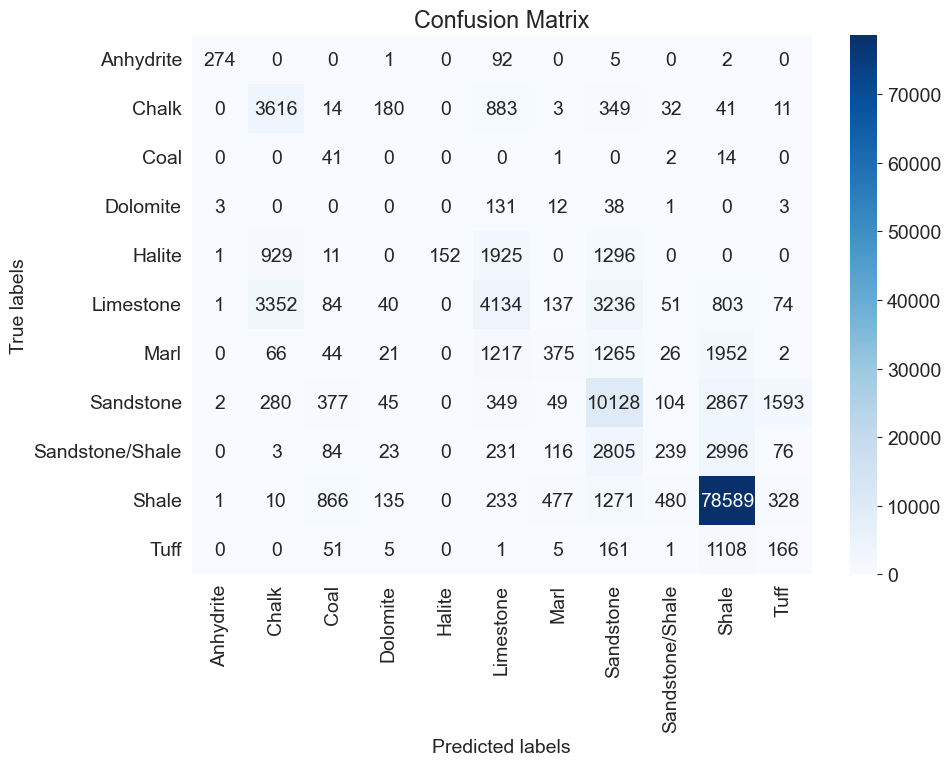

In [342]:
# Создание матрицы ошибок
conf_matrix = confusion_matrix(y_test, LR_test_preds)

conf_df = pd.DataFrame(conf_matrix, index = model_logreg.classes_, columns = model_logreg.classes_)

# Визуализация матрицы ошибок с помощью heatmap
plt.figure(figsize=(10,7))
sns.heatmap(conf_df, annot=True, cmap='Blues', fmt='g')
plt.xlabel('Predicted labels')
plt.ylabel('True labels')
plt.title('Confusion Matrix')
plt.show()

In [343]:
LR_classes = model_logreg.classes_

LR_class_counts = np.sum(conf_matrix, axis=1)

LR_results_df = pd.DataFrame({
    'Class': model_logreg.classes_,
    'Accuracy': np.round(class_accuracies, 3),
    'Count': LR_class_counts
})

LR_results_df

,Class,Accuracy,Count
0,Anhydrite,0.000,374
1,Chalk,0.000,5129
2,Coal,0.431,58
3,Dolomite,0.000,188
4,Halite,0.001,4314
5,Limestone,0.568,11912
6,Marl,0.000,4968
7,Sandstone,0.668,15794
8,Sandstone/Shale,0.045,6573
9,Shale,0.985,82390


Визуализация результатов классификации

In [344]:
results_df.loc[:, 'LR_predictions'] = model_logreg.predict(X_test)
results_df.loc[:, 'LR_predictions'] = results_df['LR_predictions'].map(lithology_keys).map(lithology_numbers)

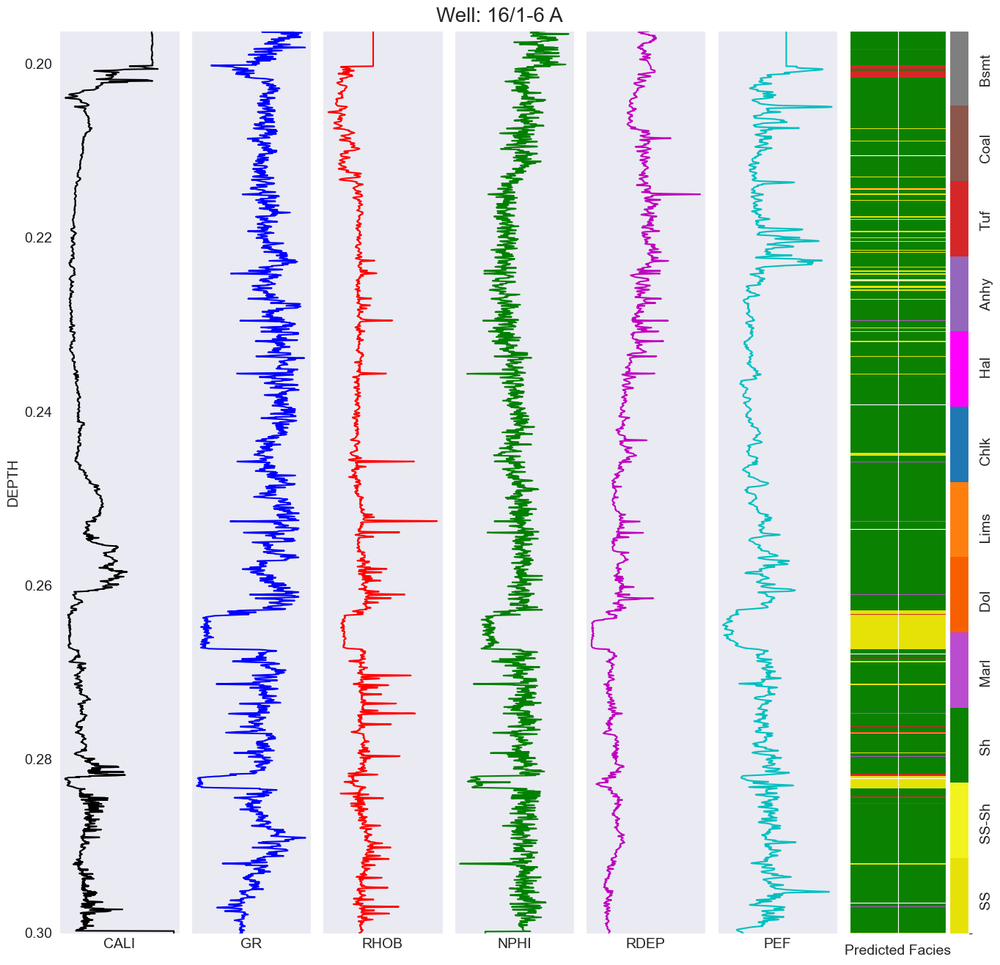

In [345]:
well_no = 4
log_plot(results_df[results_df['WELL'] == test_wells[well_no]], selected_logs, test_wells[well_no], 'LR_predictions')

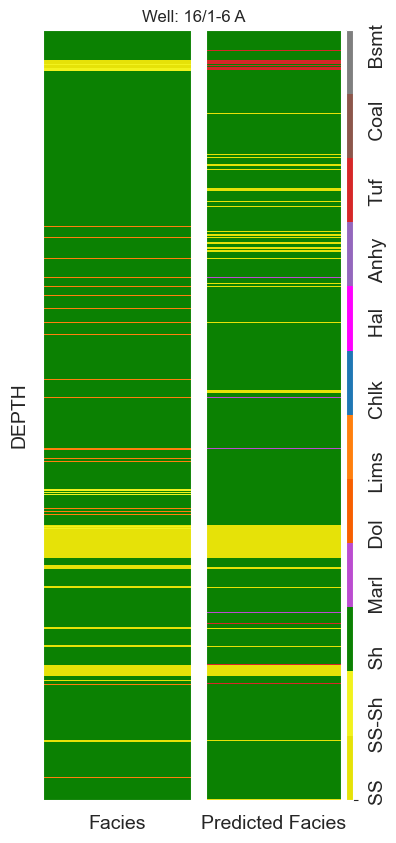

In [346]:
compare_facies(results_df[results_df['WELL'] == test_wells[well_no]], test_wells[well_no], 'LR_predictions')

Сохранение модели

In [58]:
with open('model_logreg.pkl', 'wb') as f:
    pickle.dump(model_logreg, f)

NameError: name 'pickle' is not defined

### 4.2 Решающее дерево

In [53]:
model_tree = DecisionTreeClassifier(random_state=42)

Обучение решающего дерева

In [121]:
%%time
model_tree.fit(X_train, y_train)

Wall time: 26.8 s


DecisionTreeClassifier(random_state=42)

Точность на тренировочной и тестовой выборках

In [122]:
DTC_train_preds = model_tree.predict(X_train)

In [123]:
DTC_train_accuracy = accuracy_score(DTC_train_preds, y_train)
print(f"Accuracy на тренировочной выборке: {DTC_train_accuracy:.3f}")

Accuracy на тренировочной выборке: 1.000


In [124]:
DTC_train_probs = model_tree.predict_proba(X_train)

In [125]:
DTC_train_probs

array([[0., 0., 0., ..., 0., 1., 0.],
       [0., 0., 0., ..., 0., 1., 0.],
       [0., 0., 0., ..., 0., 1., 0.],
       ...,
       [0., 0., 0., ..., 1., 0., 0.],
       [0., 0., 0., ..., 1., 0., 0.],
       [0., 0., 0., ..., 1., 0., 0.]])

In [129]:
DTC_test_preds = model_tree.predict(X_test)

In [130]:
DTC_test_accuracy = accuracy_score(y_test, DTC_test_preds)
print(f"Accuracy на тестовой выборке: {DTC_test_accuracy:.3f}")

Accuracy на валидационной выборке: 0.544


In [131]:
print(classification_report(y_test, DTC_test_preds))

                 precision    recall  f1-score   support

      Anhydrite       0.12      0.05      0.07       299
          Chalk       0.32      0.06      0.11      5129
           Coal       0.12      0.48      0.19        58
       Dolomite       0.00      0.02      0.01       188
         Halite       0.00      0.00      0.00      4314
      Limestone       0.35      0.37      0.36      8839
           Marl       0.08      0.06      0.07      2702
      Sandstone       0.26      0.45      0.33     12675
Sandstone/Shale       0.08      0.15      0.11      5737
          Shale       0.81      0.71      0.76     71343
           Tuff       0.05      0.17      0.08      1181

       accuracy                           0.54    112465
      macro avg       0.20      0.23      0.19    112465
   weighted avg       0.59      0.54      0.56    112465



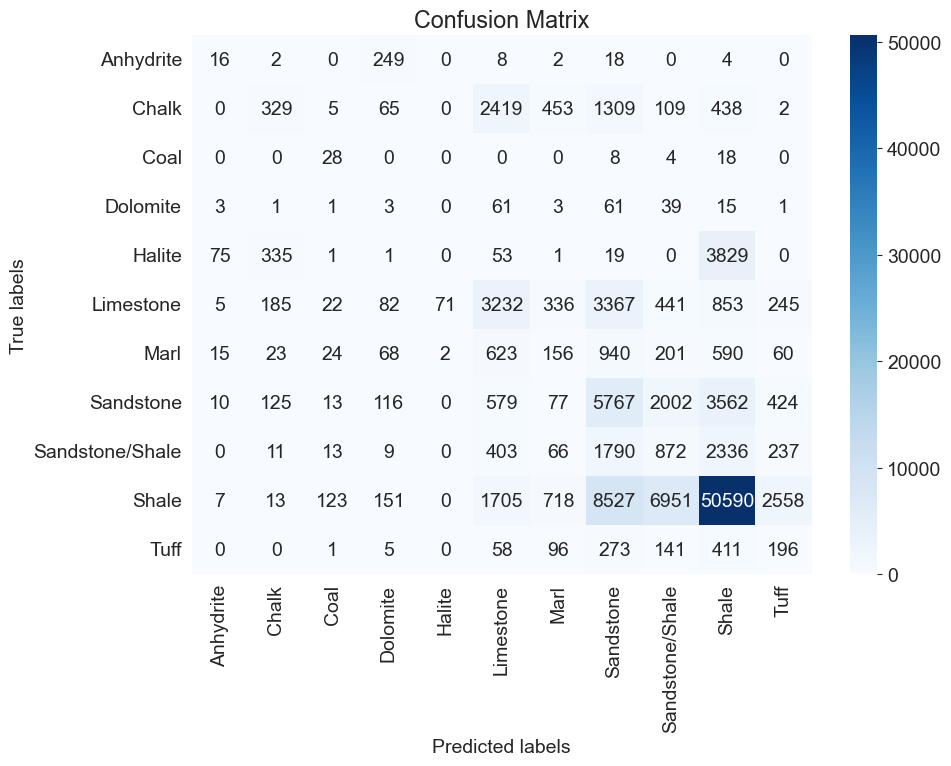

In [132]:
# Создание матрицы ошибок
conf_matrix = confusion_matrix(y_test, DTC_test_preds)

conf_df = pd.DataFrame(conf_matrix, index = model_tree.classes_, columns = model_tree.classes_)

# Визуализация матрицы ошибок с помощью heatmap
plt.figure(figsize=(10,7))
sns.heatmap(conf_df, annot=True, cmap='Blues', fmt='g')
plt.xlabel('Predicted labels')
plt.ylabel('True labels')
plt.title('Confusion Matrix')
plt.show()

Ограничим глубину дерева

In [347]:
model_tree2 = DecisionTreeClassifier(max_depth=8, random_state=42)

In [348]:
%%time
model_tree2.fit(X_train, y_train)

Wall time: 46.2 s


DecisionTreeClassifier(max_depth=8, random_state=42)

Точность на тренировочной и тестовой выборках

In [349]:
DTC2_train_preds = model_tree2.predict(X_train)
DTC2_train_accuracy = accuracy_score(DTC2_train_preds, y_train)
print(f"Accuracy на тренировочной выборке: {DTC2_train_accuracy:.3f}")

Accuracy на тренировочной выборке: 0.762


In [350]:
DTC2_test_preds = model_tree2.predict(X_test)

In [351]:
DTC2_test_preds

array(['Shale', 'Shale', 'Shale', ..., 'Shale', 'Shale', 'Shale'],
      dtype=object)

In [352]:
DTC2_test_accuracy = accuracy_score(y_test, DTC2_test_preds)
print(f"Accuracy на тестовой выборке: {DTC2_test_accuracy:.3f}")

Accuracy на тестовой выборке: 0.727


Отчет о классификации на тестовой выборке

In [353]:
print(classification_report(y_test, DTC2_test_preds, digits=3, zero_division=1))

                 precision    recall  f1-score   support

      Anhydrite      0.985     0.695     0.815       374
          Chalk      0.565     0.198     0.293      5129
           Coal      0.154     0.103     0.124        58
       Dolomite      1.000     0.000     0.000       188
         Halite      1.000     0.000     0.000      4314
      Limestone      0.419     0.501     0.456     11912
           Marl      0.490     0.069     0.120      4968
      Sandstone      0.544     0.660     0.596     15794
Sandstone/Shale      0.224     0.163     0.189      6573
          Shale      0.856     0.944     0.898     82390
           Tuff      0.000     0.000     0.000      1498

       accuracy                          0.727    133198
      macro avg      0.567     0.303     0.317    133198
   weighted avg      0.719     0.727     0.694    133198



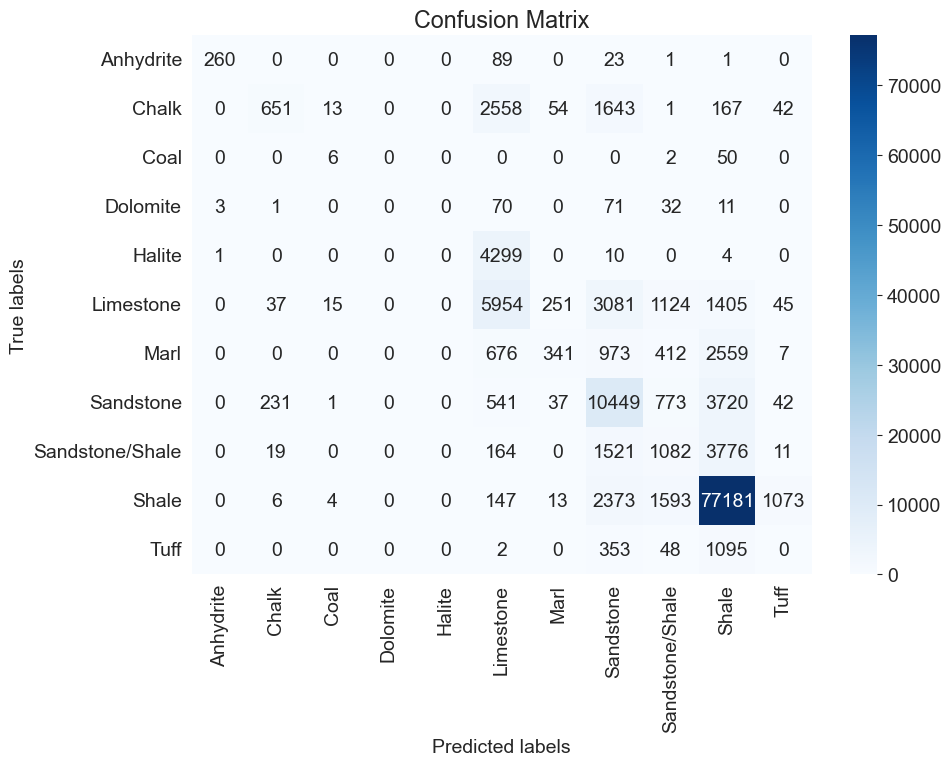

In [66]:
# Создание матрицы ошибок
conf_matrix = confusion_matrix(y_test, DTC2_test_preds)

conf_df = pd.DataFrame(conf_matrix, index = model_tree2.classes_, columns = model_tree2.classes_)

# Визуализация матрицы ошибок с помощью heatmap
plt.figure(figsize=(10,7))
sns.heatmap(conf_df, annot=True, cmap='Blues', fmt='g')
plt.xlabel('Predicted labels')
plt.ylabel('True labels')
plt.title('Confusion Matrix')
plt.show()

In [355]:
DT_classes = model_logreg.classes_

DT_class_counts = np.sum(conf_matrix, axis=1)

DT_results_df = pd.DataFrame({
    'Class': model_tree2.classes_,
    'Accuracy': np.round(class_accuracies, 3),
    'Count': DT_class_counts
})

LR_results_df

,Class,Accuracy,Count
0,Anhydrite,0.000,374
1,Chalk,0.000,5129
2,Coal,0.431,58
3,Dolomite,0.000,188
4,Halite,0.001,4314
5,Limestone,0.568,11912
6,Marl,0.000,4968
7,Sandstone,0.668,15794
8,Sandstone/Shale,0.045,6573
9,Shale,0.985,82390


In [356]:
results_df['DT_predictions'] = model_tree2.predict(X_test)
results_df['DT_predictions'] = results_df['DT_predictions'].map(lithology_keys).map(lithology_numbers)

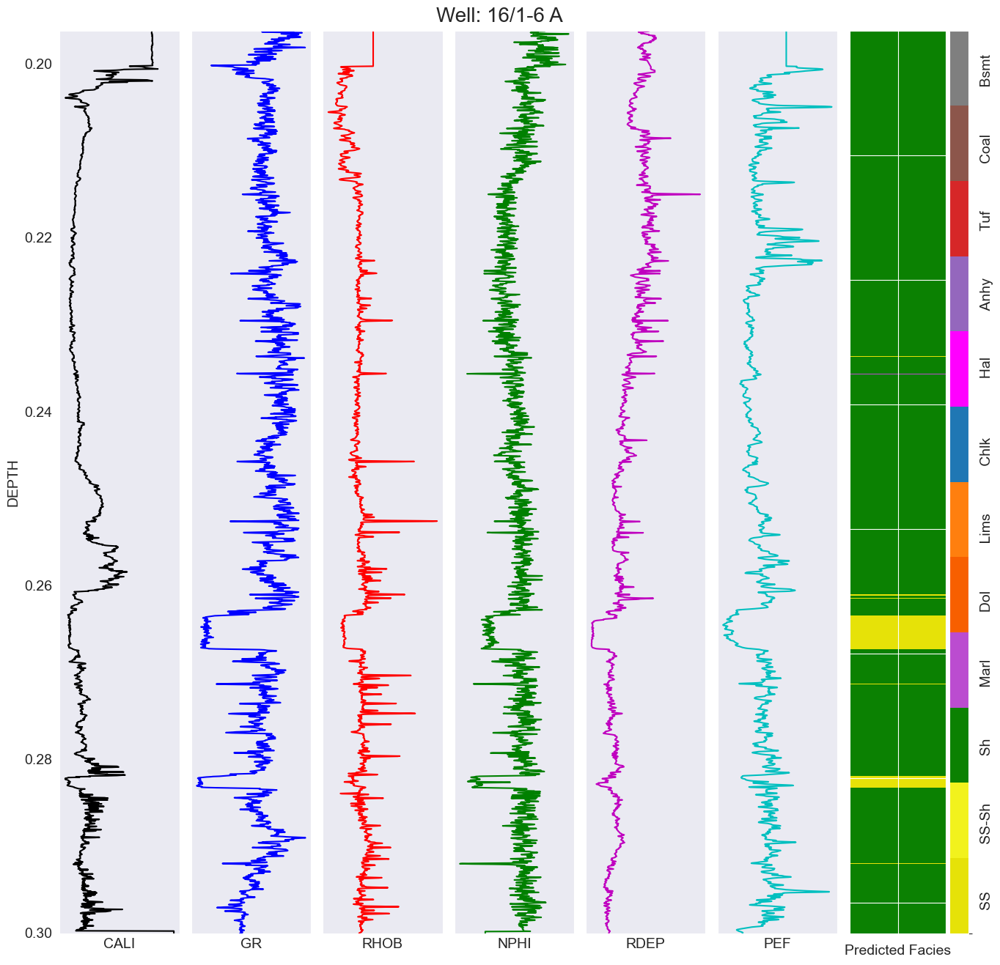

In [357]:
log_plot(results_df[results_df['WELL'] == test_wells[well_no]], selected_logs, test_wells[well_no], 'DT_predictions')

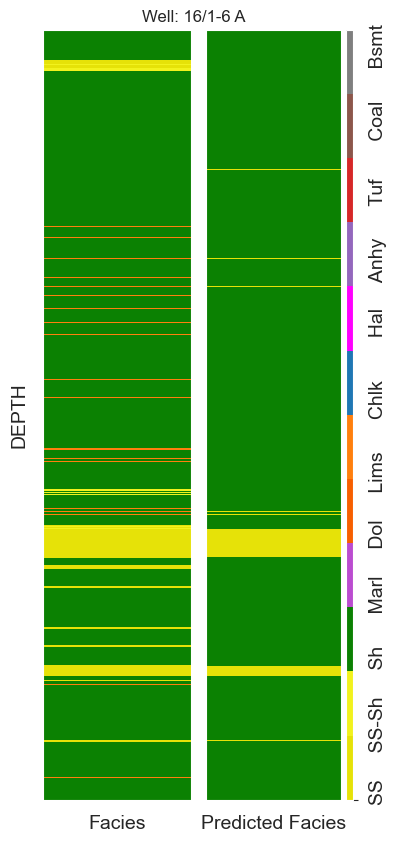

In [358]:
compare_facies(results_df[results_df['WELL'] == test_wells[well_no]], test_wells[well_no], 'DT_predictions')

Сохранение модели

In [123]:
with open('model_DT.pkl', 'wb') as f:
    pickle.dump(model_tree2, f)

### 4.3 Случайный лес

In [219]:
%%time

RF_model = RandomForestClassifier()

RF_params = {
    'n_estimators': [100, 200, 500, 700],  # количество деревьев в лесу
    'criterion': ['gini', 'entropy'],  # критерий разделения
    'max_depth': [None, 10, 20, 30, 40, 50],  # максимальная глубина дерева
    'min_samples_split': [2, 5, 10],  # минимальное количество выборок для разделения узла
    'min_samples_leaf': [1, 2, 4],  # минимальное количество выборок в листовом узле
}

rs_randforest =  RandomizedSearchCV(estimator=RF_model, param_distributions=RF_params, cv=3, scoring='accuracy', n_iter=10, random_state=42)

rs_randforest.fit(X_train, y_train)

Wall time: 9h 53s


RandomizedSearchCV(cv=3, estimator=RandomForestClassifier(),
                   param_distributions={'criterion': ['gini', 'entropy'],
                                        'max_depth': [None, 10, 20, 30, 40, 50],
                                        'min_samples_leaf': [1, 2, 4],
                                        'min_samples_split': [2, 5, 10],
                                        'n_estimators': [100, 200, 500, 700]},
                   random_state=42, scoring='accuracy')

In [223]:
rs_randforest.best_params_

{'n_estimators': 700,
 'min_samples_split': 10,
 'min_samples_leaf': 2,
 'max_depth': 10,
 'criterion': 'entropy'}

In [361]:
RF_params = {'n_estimators': 700,
 'min_samples_split': 10,
 'min_samples_leaf': 2,
 'max_depth': 10,
 'criterion': 'entropy'}

In [362]:
model_randomforest = RandomForestClassifier()

In [365]:
model_randomforest.set_params(**RF_params)

RandomForestClassifier(criterion='entropy', max_depth=10, min_samples_leaf=2,
                       min_samples_split=10, n_estimators=700)

In [366]:
%%time
model_randomforest.fit(X_train, y_train)

KeyboardInterrupt: 

In [ ]:
RF_train_preds = model_randomforest.predict(X_train)
RF_train_preds

In [ ]:
accuracy_score(RF_train_preds, y_train)

In [ ]:
test_preds_ranfor = model_randomforest.predict(X_test)

In [ ]:
test_preds_ranfor

In [ ]:
accuracy_score(test_preds_ranfor, y_test)

In [ ]:
model_randomforest.score(X_test, y_test)

In [ ]:
print(classification_report(y_test, test_preds_ranfor, digits = 3))

In [139]:
with open('model_randomforest.pkl', 'wb') as f:
    pickle.dump(model_randomforest, f)

### 4.5 X-GB Classifier

In [ ]:
#Кодирование целевой переменной в числовые значения
y_train_encoded = y_train.map(lithology_keys).map(lithology_numbers)

y_test_encoded = y_test.map(lithology_keys).map(lithology_numbers)

In [ ]:
model_XGboost = XGBClassifier(random_state=42)

In [481]:
%%time

XGboost_params = {
    'n_estimators': [100, 200, 300, 350],
    'max_depth': [3, 6, 9],
    'learning_rate': [0.01, 0.1, 0.3]
}

gs_XGboost = RandomizedSearchCV(estimator=model_XGboost, param_distributions=XGboost_params, cv=3, scoring='accuracy', n_jobs=-1)

gs_XGboost.fit(X_train, y_train_encoded)

ValueError: Found input variables with inconsistent numbers of samples: [1011072, 1057943]

In [ ]:
gs_XGboost.best_params_

In [221]:
gs_XGboost.best_params_

{'n_estimators': 300, 'max_depth': 6, 'learning_rate': 0.01}

In [72]:
gs_XGboost.best_estimator_.score(inputs_train, targets_train_encoded)

NameError: name 'gs_XGboost' is not defined

In [368]:
XGboost_best_params = {'n_estimators': 100,
                       'max_depth': 3,
                       'learning_rate': 0.01,
                      'class_weight': 'balanced'}

In [369]:
model_XGboost.set_params(**XGboost_best_params)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              class_weight='balanced', colsample_bylevel=None,
              colsample_bynode=None, colsample_bytree=None, device=None,
              early_stopping_rounds=None, enable_categorical=False,
              eval_metric=None, feature_types=None, gamma=None,
              grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=0.01, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=3, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=100, n_jobs=None,
              num_parallel_tree=None, ...)

In [370]:
%%time
model_XGboost.fit(X_train, y_train_encoded)

Wall time: 1min 28s


XGBClassifier(base_score=None, booster=None, callbacks=None,
              class_weight='balanced', colsample_bylevel=None,
              colsample_bynode=None, colsample_bytree=None, device=None,
              early_stopping_rounds=None, enable_categorical=False,
              eval_metric=None, feature_types=None, gamma=None,
              grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=0.01, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=3, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=100, n_jobs=None,
              num_parallel_tree=None, ...)

Оценка метрик на обучающих и валидационных выборках

In [371]:
XGboost_train_preds = model_XGboost.predict(X_train)

In [372]:
XGB_train_accuracy = accuracy_score(XGboost_train_preds, y_train_encoded)
print(f"Accuracy на тренировочной выборке: {XGB_train_accuracy:.3f}")

Accuracy на тренировочной выборке: 0.713


In [373]:
XGboost_test_preds = model_XGboost.predict(X_test)

In [374]:
XGB_test_accuracy = accuracy_score(XGboost_test_preds, y_test_encoded)
print(f"Accuracy на тестовой выборке: {XGB_test_accuracy:.3f}")

Accuracy на тестовой выборке: 0.734


Отчет о классификации

In [375]:
print(classification_report(y_test_encoded, XGboost_test_preds, digits = 3, zero_division = 1))

              precision    recall  f1-score   support

           0      0.458     0.559     0.504     15794
           1      0.088     0.003     0.005      6573
           2      0.822     0.988     0.897     82390
           3      1.000     0.000     0.000      4968
           4      1.000     0.000     0.000       188
           5      0.453     0.498     0.474     11912
           6      0.950     0.246     0.391      5129
           7      1.000     0.000     0.000      4314
           8      0.985     0.706     0.822       374
           9      1.000     0.000     0.000      1498
          10      0.464     0.448     0.456        58

    accuracy                          0.734    133198
   macro avg      0.747     0.313     0.323    133198
weighted avg      0.729     0.734     0.675    133198



Матрица ошибок

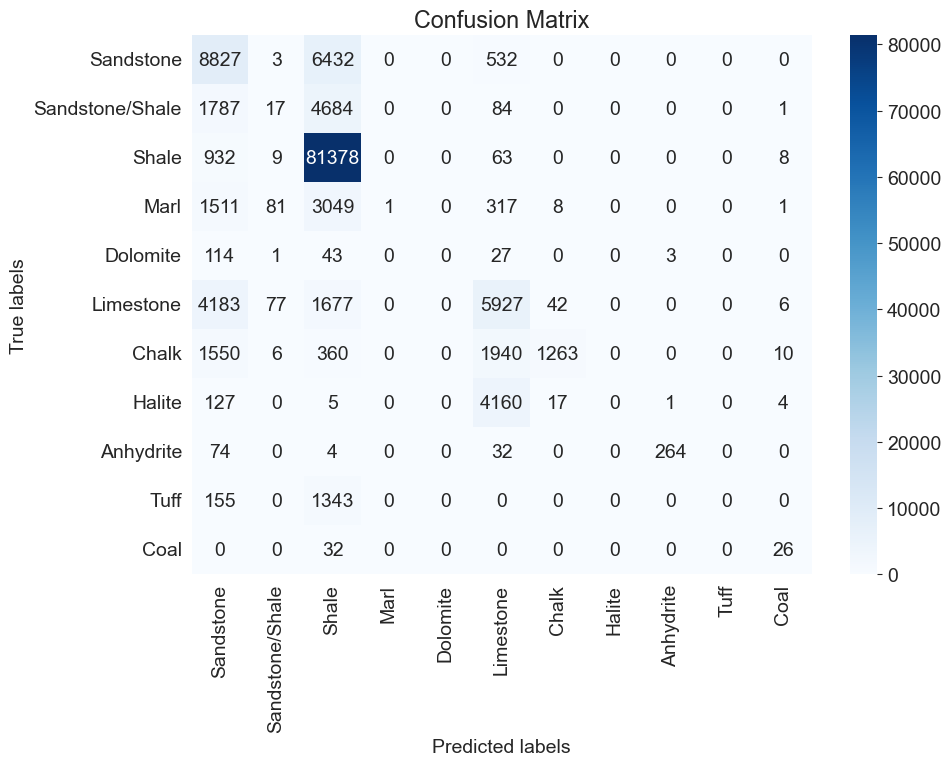

In [376]:
conf_matrix = confusion_matrix(y_test_encoded, XGboost_test_preds)

classes = ['Anhydrite', 'Chalk', 'Coal', 'Dolomite', 'Halite', 'Limestone',
       'Marl', 'Sandstone', 'Sandstone/Shale', 'Shale', 'Tuff']

conf_df = pd.DataFrame(conf_matrix, index=mapped_classes, columns=mapped_classes)

# Визуализация матрицы ошибок с помощью heatmap
plt.figure(figsize=(10, 7))
sns.heatmap(conf_df, annot=True, cmap='Blues', fmt='g')
plt.xlabel('Predicted labels')
plt.ylabel('True labels')
plt.title('Confusion Matrix')
plt.show()

In [399]:
lithology_numbs = {
    0: 'Sandstone',
    1: 'Sandstone/Shale',
    2: 'Shale',
    3: 'Marl',
    4: 'Dolomite',
    5: 'Limestone',
    6: 'Chalk',
    7: 'Halite',
    8: 'Anhydrite',
    9: 'Tuff',
    10: 'Coal',
}

In [400]:
# Преобразование классов модели в DataFrame для использования .map()
model_classes_series = pd.Series(model_XGboost.classes_)

# Обратное преобразование через словари
mapped_classes = model_classes_series.map(lithology_numbs)


In [379]:
LGBM_classes = model_lgbm.classes_

LGBM_class_counts = np.sum(conf_matrix, axis=1)

LGBM_results_df = pd.DataFrame({
    'Class': mapped_classes,
    'Accuracy': np.round(class_accuracies, 3),
    'Count': LGBM_class_counts
})

LGBM_results_df

,Class,Accuracy,Count
0,Sandstone,0.000,15794
1,Sandstone/Shale,0.000,6573
2,Shale,0.431,82390
3,Marl,0.000,4968
4,Dolomite,0.001,188
5,Limestone,0.568,11912
6,Chalk,0.000,5129
7,Halite,0.668,4314
8,Anhydrite,0.045,374
9,Tuff,0.985,1498


In [380]:
feature_importances = model_XGboost.feature_importances_
feature_names = X_train.columns

feature_importance_df = pd.DataFrame({
    'Feature': feature_names,
    'Importance': feature_importances
})

# Сортировка признаков по важности в убывающем порядке
feature_importance_df = feature_importance_df.sort_values(by='Importance', ascending=False)

print(feature_importance_df)

    Feature  Importance
6        GR    0.250163
9      NPHI    0.180277
1      CALI    0.153429
7       DTC    0.101497
3      RMED    0.084858
5      RHOB    0.071655
4      RDEP    0.043480
0  DEPTH_MD    0.040183
8      DRHO    0.037392
2      RSHA    0.037066


Визуализация результатов классификации

In [381]:
results_df['XGboost_predictions'] = model_XGboost.predict(X_test)

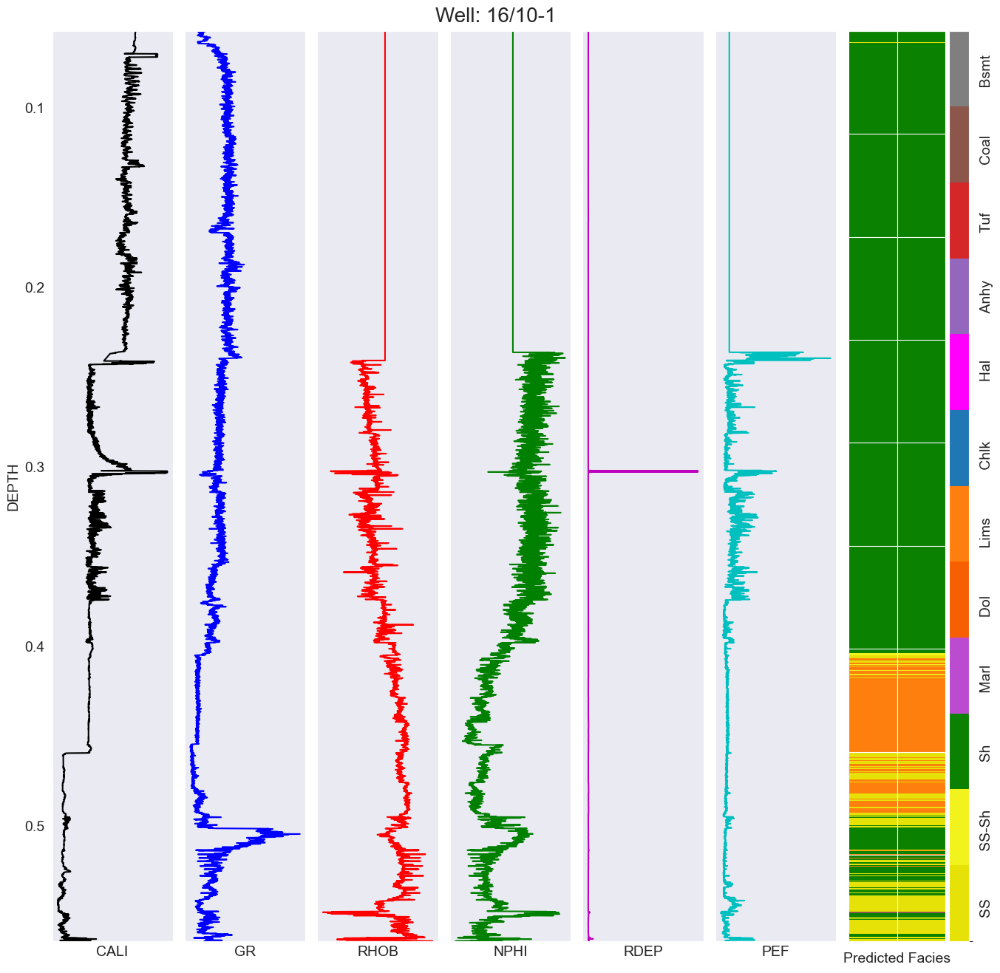

In [382]:
well_no = 5

log_plot(results_df[results_df['WELL'] == test_wells[well_no]], selected_logs, test_wells[well_no], 'XGboost_predictions')

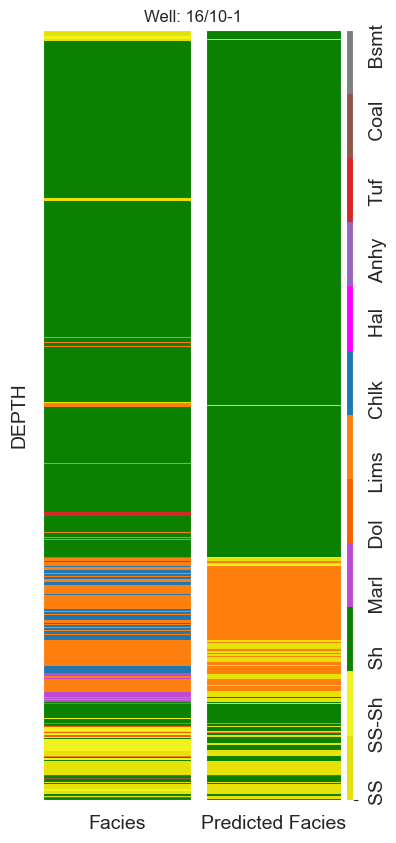

In [383]:
compare_facies(results_df[results_df['WELL'] == test_wells[well_no]], test_wells[well_no], 'XGboost_predictions')

In [ ]:
compare_all_facies(results_df[results_df['WELL'] == test_wells[well_no]], test_wells[well_no], ['LR_predictions', 'XGboost_predictions'])

Сохранение модели

### 4.6 LGBM Classifier

In [384]:
param = {'num_leaves': 150, #120,
         'num_iterations': 500, #400,
         'max_depth': 15,
         'learning_rate': 0.05,
         'feature_fraction': 0.4, #0.5,
         'class_weight': None,
         'bagging_fraction': 0.9 #0.8
        }

In [385]:
model_lgbm = lgbm.LGBMClassifier(random_seed = 42)

In [90]:
model_lgbm.set_params(**param)

LGBMClassifier(bagging_fraction=0.9, feature_fraction=0.4, learning_rate=0.05,
               max_depth=15, num_iterations=500, num_leaves=150,
               random_seed=42)

Обучение LGBM Classifier

In [386]:
%%time
model_lgbm.fit(X_train, y_train)

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.193754 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2550
[LightGBM] [Info] Number of data points in the train set: 1037210, number of used features: 10
[LightGBM] [Info] Start training from score -7.285373
[LightGBM] [Info] Start training from score -5.260858
[LightGBM] [Info] Start training from score -5.619339
[LightGBM] [Info] Start training from score -6.538825
[LightGBM] [Info] Start training from score -5.583570
[LightGBM] [Info] Start training from score -3.150870
[LightGBM] [Info] Start training from score -3.599275
[LightGBM] [Info] Start training from score -1.912918
[LightGBM] [Info] Start training from score -1.975296
[LightGBM] [Info] Start training from score -0.485304
[LightGBM] [Info] Start training from score -4.323469
Wall time: 2min 2s


LGBMClassifier(random_seed=42)

Получение предсказаний

In [387]:
LGBM_train_preds = model_lgbm.predict(X_train)

In [388]:
LGBM_test_preds = model_lgbm.predict(X_test)

Точность на тренировочной и тестовой выборках

In [389]:
LGBM_train_accuracy = accuracy_score(LGBM_train_preds, y_train)
print(f"Accuracy на тренировочной выборке: {LGBM_train_accuracy:.3f}")

Accuracy на тренировочной выборке: 0.837


In [390]:
LGBM_test_accuracy = accuracy_score(LGBM_test_preds, y_test)
print(f"Accuracy на тестовой выборке: {LGBM_test_accuracy:.3f}")

Accuracy на тестовой выборке: 0.725


Отчет о классификации

In [391]:
print(classification_report(y_test, LGBM_test_preds, digits = 3))

                 precision    recall  f1-score   support

      Anhydrite      0.610     0.505     0.553       374
          Chalk      0.438     0.139     0.211      5129
           Coal      0.097     0.655     0.169        58
       Dolomite      0.049     0.053     0.051       188
         Halite      0.000     0.000     0.000      4314
      Limestone      0.443     0.608     0.513     11912
           Marl      0.273     0.134     0.180      4968
      Sandstone      0.577     0.676     0.623     15794
Sandstone/Shale      0.155     0.121     0.136      6573
          Shale      0.869     0.925     0.896     82390
           Tuff      0.068     0.022     0.033      1498

       accuracy                          0.725    133198
      macro avg      0.325     0.349     0.306    133198
   weighted avg      0.683     0.725     0.697    133198



Матрица ошибок

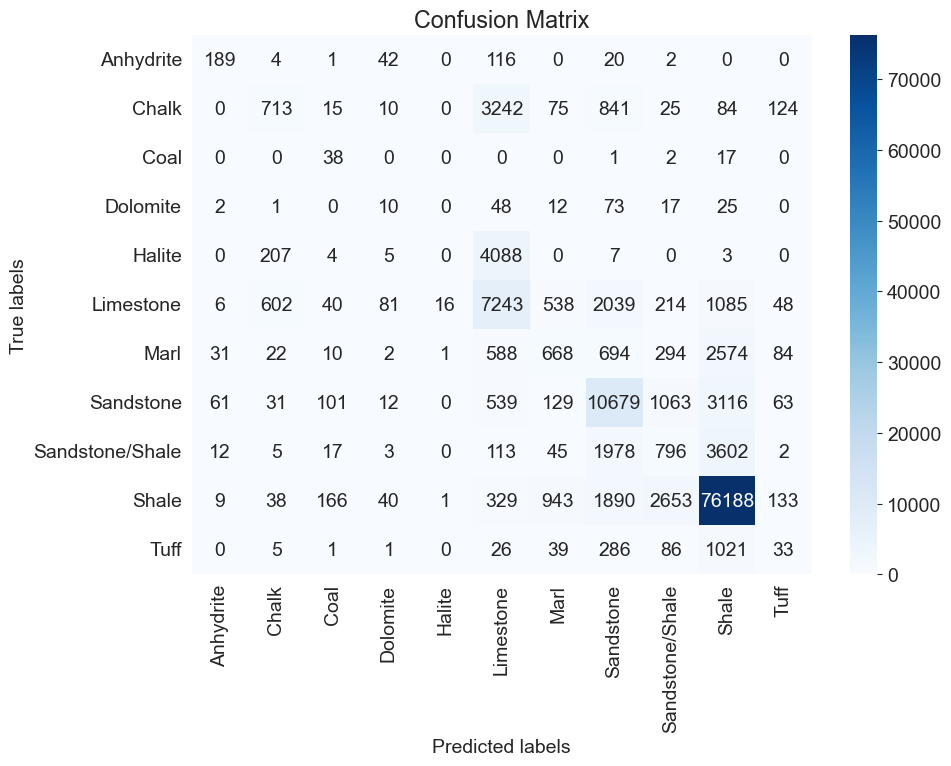

In [392]:
conf_matrix = confusion_matrix(y_test, LGBM_test_preds)

conf_df = pd.DataFrame(conf_matrix, index=model_lgbm.classes_, columns=model_lgbm.classes_)

# Визуализация матрицы ошибок с помощью heatmap
plt.figure(figsize=(10, 7))
sns.heatmap(conf_df, annot=True, cmap='Blues', fmt='g')
plt.xlabel('Predicted labels')
plt.ylabel('True labels')
plt.title('Confusion Matrix')
plt.show()

In [393]:
LGBM_classes = model_lgbm.classes_

LGBM_class_counts = np.sum(conf_matrix, axis=1)

LGBM_results_df = pd.DataFrame({
    'Class': LGBM_classes,
    'Accuracy': np.round(class_accuracies, 3),
    'Count': LGBM_class_counts
})

LGBM_results_df

,Class,Accuracy,Count
0,Anhydrite,0.000,374
1,Chalk,0.000,5129
2,Coal,0.431,58
3,Dolomite,0.000,188
4,Halite,0.001,4314
5,Limestone,0.568,11912
6,Marl,0.000,4968
7,Sandstone,0.668,15794
8,Sandstone/Shale,0.045,6573
9,Shale,0.985,82390


In [403]:
results_df['LGBM_predictions'] = LGBM_test_preds
results_df['LGBM_predictions'] = results_df['LGBM_predictions'].map(lithology_keys).map(lithology_numbers)

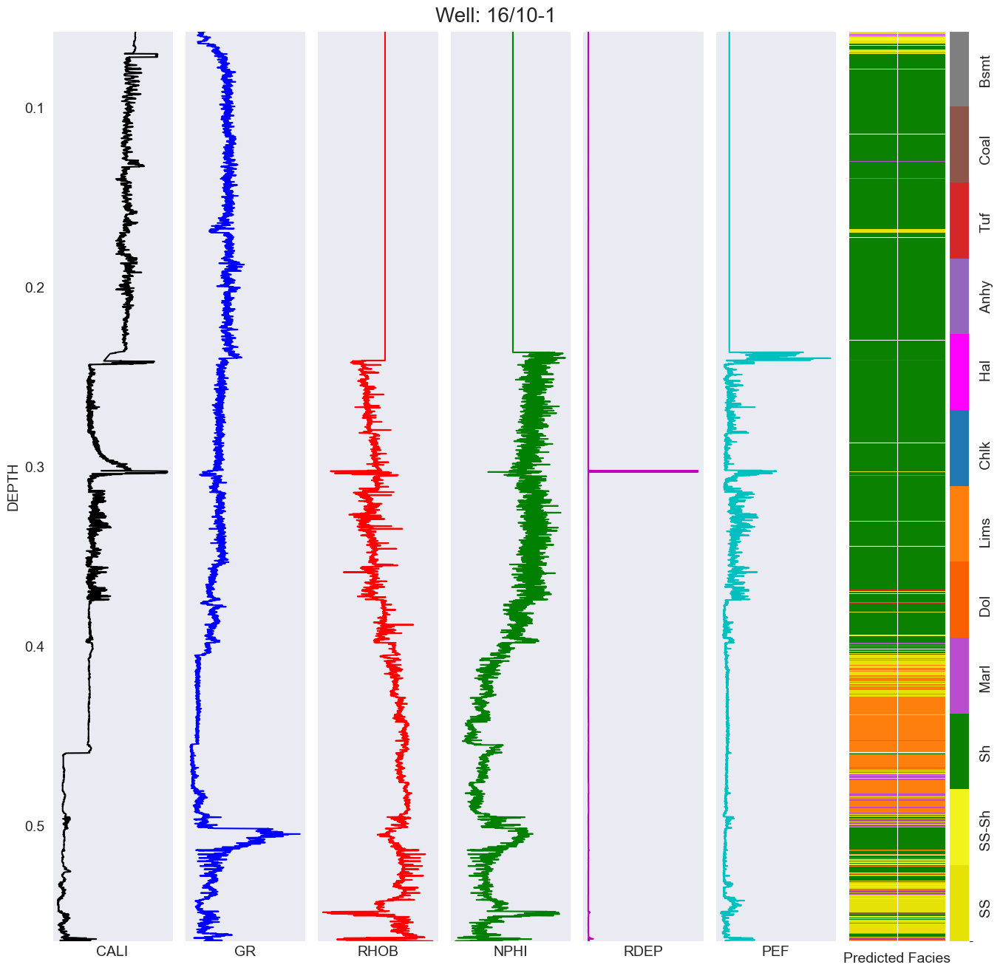

In [404]:
well_no = 5

log_plot(results_df[results_df['WELL'] == test_wells[well_no]], selected_logs, test_wells[well_no], 'LGBM_predictions')

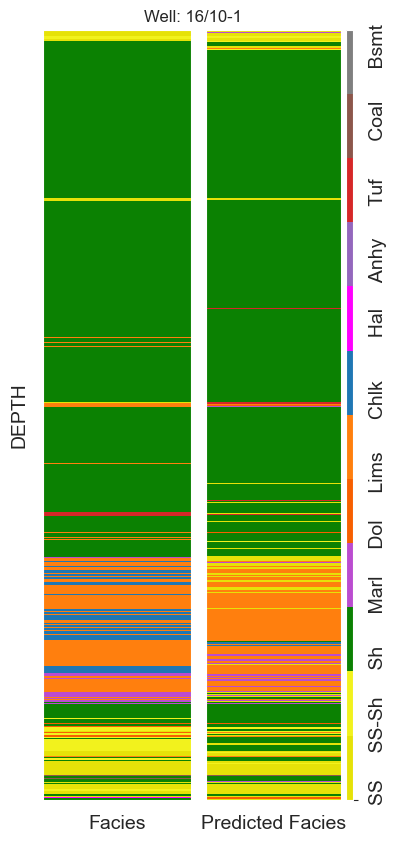

In [405]:
compare_facies(results_df[results_df['WELL'] == test_wells[well_no]], test_wells[well_no], 'LGBM_predictions')

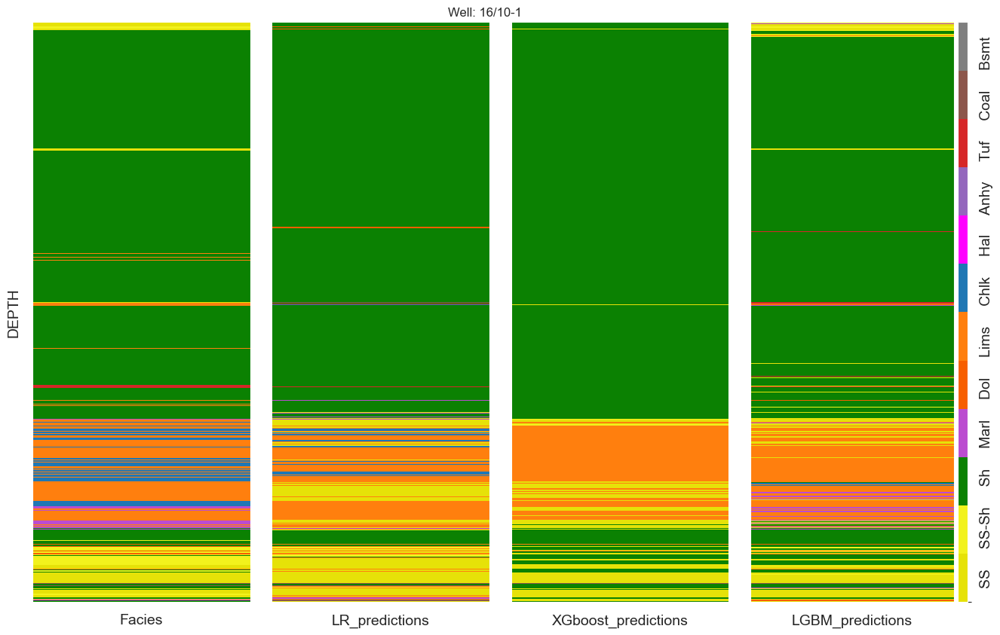

In [406]:
compare_all_facies(results_df[results_df['WELL'] == test_wells[well_no]], test_wells[well_no], ['LR_predictions', 'XGboost_predictions', 'LGBM_predictions'])

Сохранение модели

In [122]:
with open('model_lgbm.pkl', 'wb') as f:
    pickle.dump(model_lgbm, f)

### 4.7 Catboost Classifier

In [408]:
catboost_model = CatBoostClassifier(random_seed = 42)

In [482]:
%%time

CatBoost_params = {
    'iterations': [1200, 300, 400, 500],  # количество итераций
    'learning_rate': [0.01, 0.05, 0.1],  # скорость обучения
    'depth': [4, 6, 8],  # глубина деревьев
    'border_count': [32, 64, 128],  # число бинов для числовых признаков
}


rs_catboost =  RandomizedSearchCV(estimator=catboost_classifier, param_distributions=CatBoost_params, cv=3, scoring='accuracy', n_iter=10, random_state=42)

rs_catboost.fit(X_train, y_train)

NameError: name 'inputs_train' is not defined

In [483]:
rs_catboost.best_params_

AttributeError: 'RandomizedSearchCV' object has no attribute 'best_params_'

In [409]:
catboost_best_params = {'learning_rate': 0.01,
          'l2_leaf_reg': 1,
          'iterations': 400,
          'depth': 4,
          'border_count': 64}

catboost_model.set_params(**catboost_best_params)

In [410]:
catboost_classifier = CatBoostClassifier(iterations = 500,
                                         learning_rate= 0.08, 
                                         depth= 4, 
                                         min_data_in_leaf= 50, 
                                         bagging_temperature= 4, 
                                         border_count= 100  
                                        )

In [411]:
%%time
catboost_model.fit(X_train, y_train)

0:	learn: 2.3493040	total: 1.43s	remaining: 9m 31s
1:	learn: 2.3042478	total: 2.88s	remaining: 9m 34s
2:	learn: 2.2622592	total: 4.31s	remaining: 9m 30s
3:	learn: 2.2232505	total: 5.61s	remaining: 9m 14s
4:	learn: 2.1866559	total: 6.8s	remaining: 8m 57s
5:	learn: 2.1520729	total: 8.16s	remaining: 8m 55s
6:	learn: 2.1192928	total: 10s	remaining: 9m 22s
7:	learn: 2.0887171	total: 11.4s	remaining: 9m 16s
8:	learn: 2.0594043	total: 12.7s	remaining: 9m 12s
9:	learn: 2.0313235	total: 14s	remaining: 9m 4s
10:	learn: 2.0047210	total: 15.4s	remaining: 9m 5s
11:	learn: 1.9793002	total: 16.8s	remaining: 9m 3s
12:	learn: 1.9546912	total: 18.3s	remaining: 9m 5s
13:	learn: 1.9314022	total: 19.6s	remaining: 9m
14:	learn: 1.9091180	total: 20.9s	remaining: 8m 57s
15:	learn: 1.8875574	total: 22.3s	remaining: 8m 56s
16:	learn: 1.8668400	total: 23.9s	remaining: 8m 59s
17:	learn: 1.8469066	total: 25s	remaining: 8m 51s
18:	learn: 1.8277980	total: 26.5s	remaining: 8m 50s
19:	learn: 1.8092912	total: 27.7s	rem

156:	learn: 0.9941998	total: 3m 34s	remaining: 5m 32s
157:	learn: 0.9922539	total: 3m 36s	remaining: 5m 30s
158:	learn: 0.9905068	total: 3m 37s	remaining: 5m 29s
159:	learn: 0.9888286	total: 3m 38s	remaining: 5m 28s
160:	learn: 0.9868593	total: 3m 40s	remaining: 5m 26s
161:	learn: 0.9851791	total: 3m 41s	remaining: 5m 25s
162:	learn: 0.9833687	total: 3m 42s	remaining: 5m 24s
163:	learn: 0.9815705	total: 3m 44s	remaining: 5m 22s
164:	learn: 0.9797168	total: 3m 45s	remaining: 5m 20s
165:	learn: 0.9779908	total: 3m 46s	remaining: 5m 19s
166:	learn: 0.9761105	total: 3m 47s	remaining: 5m 17s
167:	learn: 0.9744805	total: 3m 48s	remaining: 5m 16s
168:	learn: 0.9727450	total: 3m 50s	remaining: 5m 14s
169:	learn: 0.9709492	total: 3m 51s	remaining: 5m 13s
170:	learn: 0.9691449	total: 3m 52s	remaining: 5m 11s
171:	learn: 0.9674409	total: 3m 54s	remaining: 5m 10s
172:	learn: 0.9658524	total: 3m 55s	remaining: 5m 8s
173:	learn: 0.9641048	total: 3m 56s	remaining: 5m 7s
174:	learn: 0.9625027	total: 3

309:	learn: 0.8329787	total: 6m 52s	remaining: 1m 59s
310:	learn: 0.8324564	total: 6m 53s	remaining: 1m 58s
311:	learn: 0.8318529	total: 6m 54s	remaining: 1m 56s
312:	learn: 0.8312400	total: 6m 55s	remaining: 1m 55s
313:	learn: 0.8307679	total: 6m 56s	remaining: 1m 54s
314:	learn: 0.8302445	total: 6m 57s	remaining: 1m 52s
315:	learn: 0.8296889	total: 6m 58s	remaining: 1m 51s
316:	learn: 0.8292142	total: 6m 59s	remaining: 1m 49s
317:	learn: 0.8284688	total: 7m 1s	remaining: 1m 48s
318:	learn: 0.8278043	total: 7m 2s	remaining: 1m 47s
319:	learn: 0.8272285	total: 7m 4s	remaining: 1m 46s
320:	learn: 0.8266476	total: 7m 5s	remaining: 1m 44s
321:	learn: 0.8261769	total: 7m 6s	remaining: 1m 43s
322:	learn: 0.8255825	total: 7m 7s	remaining: 1m 41s
323:	learn: 0.8249955	total: 7m 8s	remaining: 1m 40s
324:	learn: 0.8244472	total: 7m 9s	remaining: 1m 39s
325:	learn: 0.8239059	total: 7m 10s	remaining: 1m 37s
326:	learn: 0.8234695	total: 7m 12s	remaining: 1m 36s
327:	learn: 0.8230341	total: 7m 13s	

Получение предсказаний

In [412]:
CB_train_preds = catboost_model.predict(X_train)

In [413]:
CB_test_preds = catboost_model.predict(X_test)

Точность на тренировочной и тестовой выборках

In [414]:
CB_train_accuracy = accuracy_score(CB_train_preds, y_train)
print(f"Accuracy на тренировочной выборке: {CB_train_accuracy:.3f}")

Accuracy на тренировочной выборке: 0.733


In [424]:
CB_test_accuracy = accuracy_score(CB_test_preds, y_test)
print(f"Accuracy на тестовой выборке: {CB_test_accuracy:.3f}")

Accuracy на тестовой выборке: 0.745


In [416]:
print(classification_report(y_test, CB_test_preds, digits = 3, zero_division = 1))

                 precision    recall  f1-score   support

      Anhydrite      1.000     0.000     0.000       374
          Chalk      1.000     0.000     0.000      5129
           Coal      0.905     0.328     0.481        58
       Dolomite      1.000     0.000     0.000       188
         Halite      0.977     0.098     0.178      4314
      Limestone      0.614     0.597     0.605     11912
           Marl      0.000     0.000     0.000      4968
      Sandstone      0.433     0.662     0.523     15794
Sandstone/Shale      0.431     0.027     0.050      6573
          Shale      0.840     0.984     0.906     82390
           Tuff      1.000     0.000     0.000      1498

       accuracy                          0.745    133198
      macro avg      0.745     0.245     0.249    133198
   weighted avg      0.733     0.745     0.685    133198



Матрица ошибок

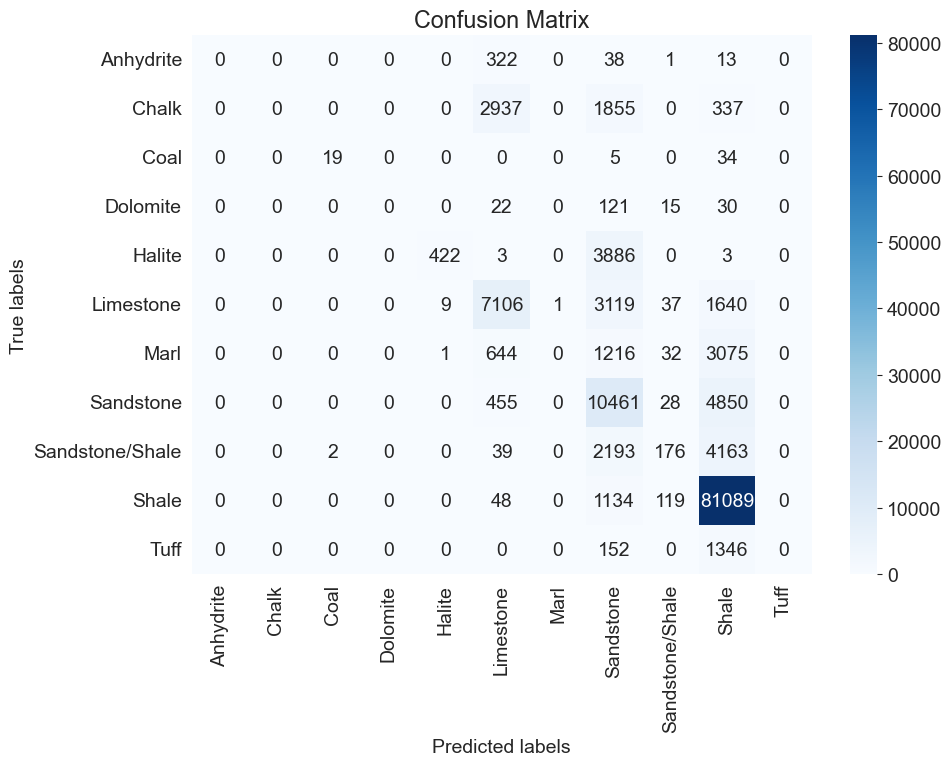

In [417]:
conf_matrix = confusion_matrix(y_test, CB_test_preds)

conf_df = pd.DataFrame(conf_matrix, index=catboost_model.classes_, columns=catboost_model.classes_)

# Визуализация матрицы ошибок с помощью heatmap
plt.figure(figsize=(10, 7))
sns.heatmap(conf_df, annot=True, cmap='Blues', fmt='g')
plt.xlabel('Predicted labels')
plt.ylabel('True labels')
plt.title('Confusion Matrix')
plt.show()

In [418]:
catboost_classesм = catboost_model.classes_

class_counts = np.sum(conf_matrix, axis=1)

CB_results_df = pd.DataFrame({
    'Class': catboost_classes,
    'Accuracy': np.round(class_accuracies, 3),
    'Count': class_counts
})

CB_results_df

,Class,Accuracy,Count
0,Anhydrite,0.000,374
1,Chalk,0.000,5129
2,Coal,0.431,58
3,Dolomite,0.000,188
4,Halite,0.001,4314
5,Limestone,0.568,11912
6,Marl,0.000,4968
7,Sandstone,0.668,15794
8,Sandstone/Shale,0.045,6573
9,Shale,0.985,82390


In [419]:
results_df['CB_predictions'] = CB_test_preds
results_df['CB_predictions'] = results_df['CB_predictions'].map(lithology_keys).map(lithology_numbers)

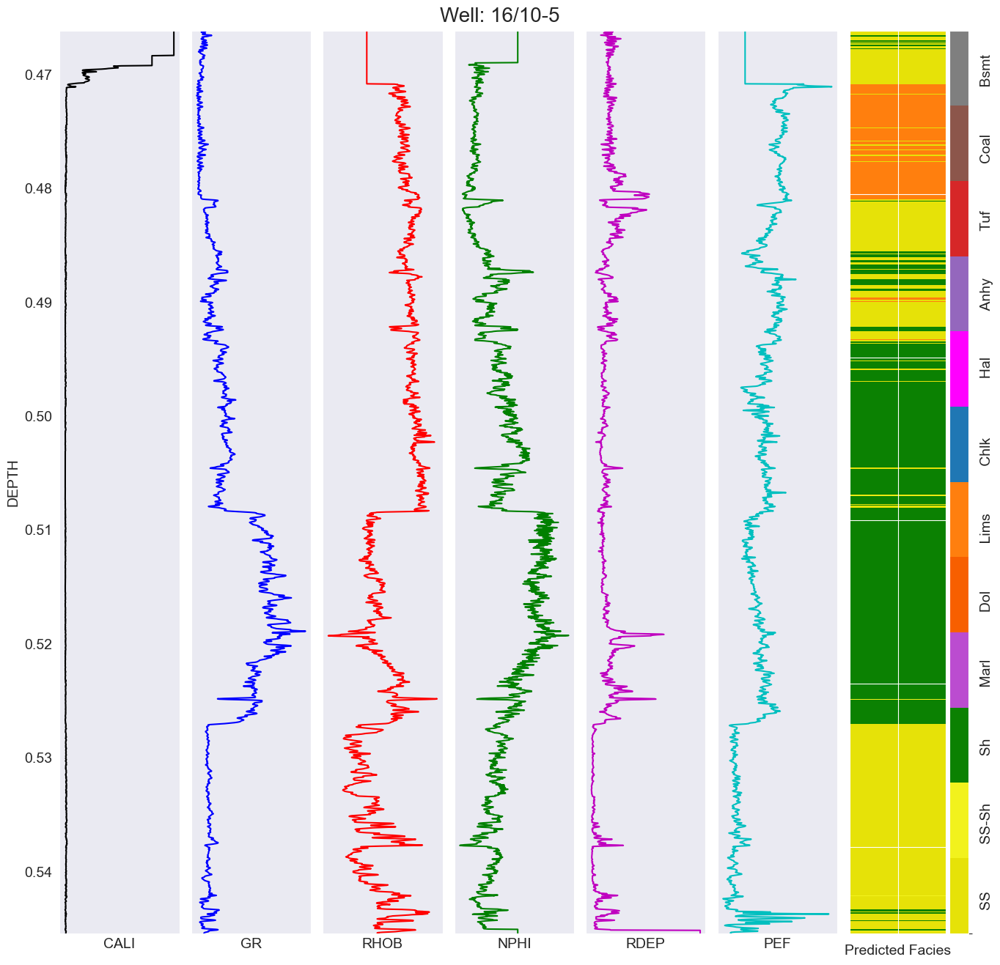

In [420]:
well_no = 8

log_plot(results_df[results_df['WELL'] == test_wells[well_no]], selected_logs, test_wells[well_no], 'CB_predictions')

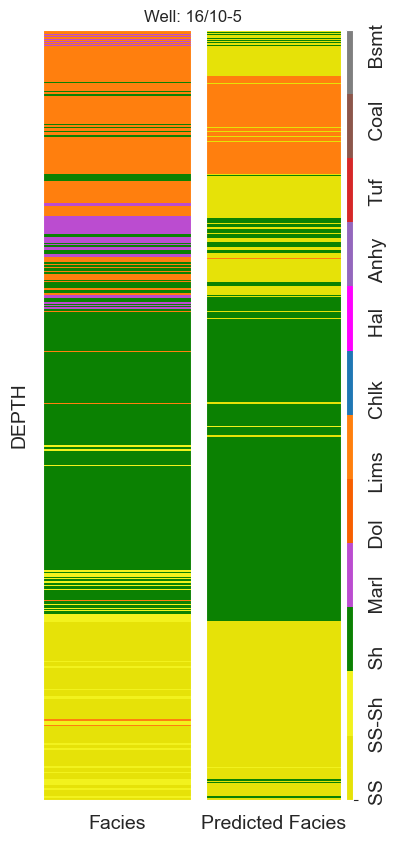

In [421]:
compare_facies(results_df[results_df['WELL'] == test_wells[well_no]], test_wells[well_no], 'CB_predictions')

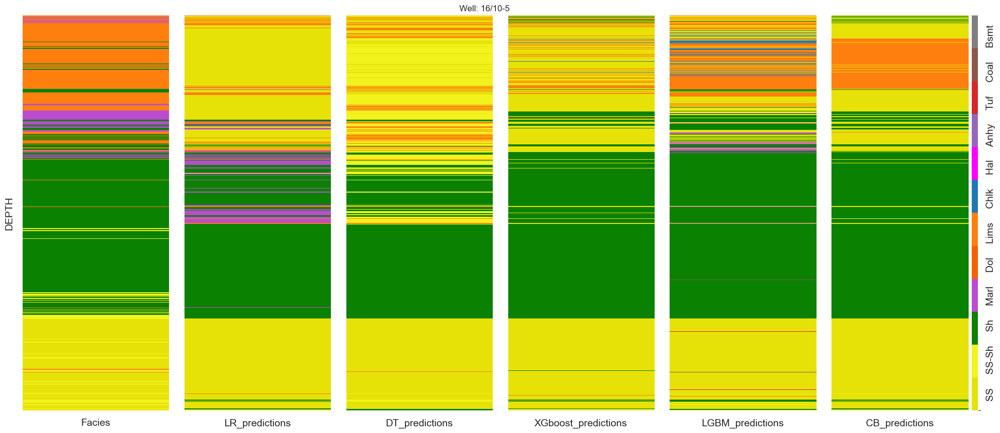

In [422]:
compare_all_facies(results_df[results_df['WELL'] == test_wells[well_no]], test_wells[well_no], ['LR_predictions', 'DT_predictions', 'XGboost_predictions','LGBM_predictions', 'CB_predictions'])

Сохранение модели

In [151]:
import pickle

with open('catboost_model.pkl', 'wb') as f:
    pickle.dump(catboost_model, f)

## 5. Подсчет и сравнение метрик

### 5.1.1 Accuracy 

#### 5.1.1 Accuracy на тренировочной выборке

In [423]:
models = ['Logistic Regression', 'Decision Tree', 'LightGBM', 'XGBoost', 'CatBoost']
accuracy_scores_train = [LR_train_accuracy, DTC2_train_accuracy, LGBM_train_accuracy, XGB_train_accuracy, CB_train_accuracy]

results_accuracy_train = pd.DataFrame({'Model': models, 'Accuracy_Score': accuracy_scores_train})
sorted_result_accuracy_train = results_accuracy_train.sort_values(by='Accuracy_Score', ascending=False).reset_index(drop=True)

sorted_result_accuracy_train

,Model,Accuracy_Score
0,LightGBM,0.836773
1,Decision Tree,0.762008
2,CatBoost,0.733101
3,XGBoost,0.713397
4,Logistic Regression,0.656352


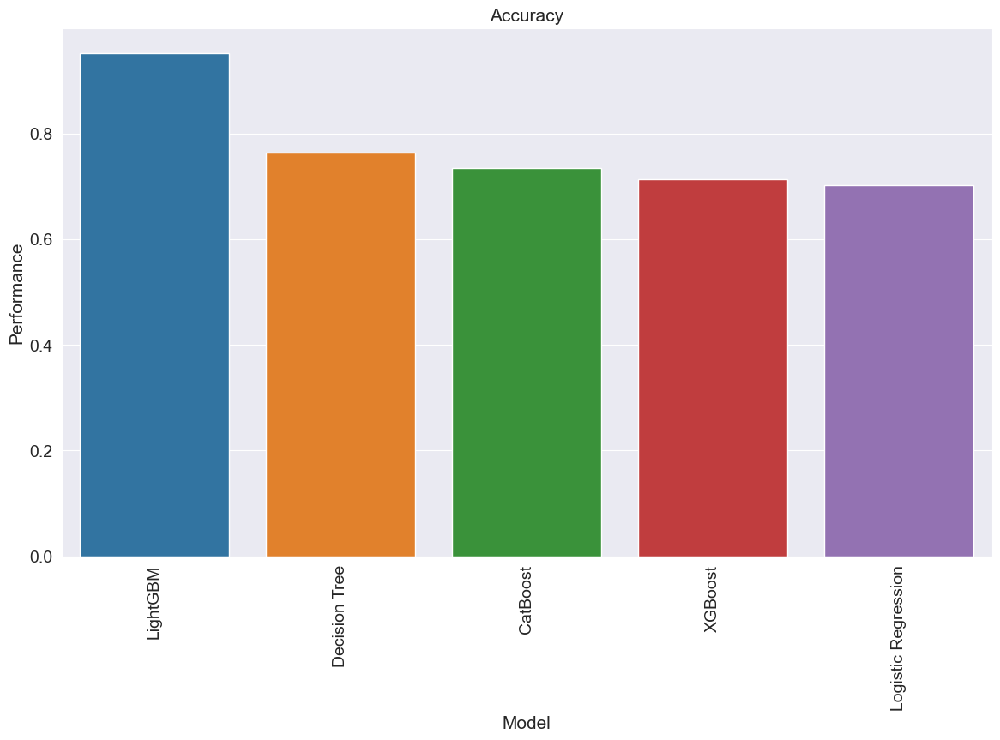

In [129]:
f, ax = plt.subplots(figsize=(14,8))
plt.xticks(rotation='90')
sns.barplot(x=sorted_result_accuracy_train['Model'], y=sorted_result_accuracy_train['Accuracy_Score'])
plt.xlabel('Model', fontsize=15)
plt.ylabel('Performance', fontsize=15)
plt.title('Accuracy', fontsize=15)
plt.show()

#### 5.1.1 Accuracy на тестовой выборке

In [425]:
accuracy_scores_test = [LR_test_accuracy, DTC2_test_accuracy, LGBM_test_accuracy, XGB_test_accuracy, CB_test_accuracy]

results_accuracy_test = pd.DataFrame({'Model': models, 'Accuracy_Score': accuracy_scores_test})
sorted_result_accuracy_test = results_accuracy_test.sort_values(by='Accuracy_Score', ascending=False).reset_index(drop=True)

sorted_result_accuracy_test

,Model,Accuracy_Score
0,CatBoost,0.745304
1,Logistic Regression,0.733600
2,XGBoost,0.733517
3,Decision Tree,0.727481
4,LightGBM,0.724913


### 5.2 F1-мера

In [427]:
DTC2_f1_score = f1_score(DTC2_test_preds, y_test, average='macro')
LGBM_f1_score = f1_score(LGBM_test_preds, y_test, average='macro')
XGB_f1_score = f1_score(XGboost_test_preds, y_test_encoded, average='macro')
CB_f1_score = f1_score(CB_test_preds, y_test, average='macro')
LR_f1_score = f1_score(LR_test_preds, y_test, average='macro')

In [429]:
DTC2_recall_score = recall_score(DTC2_test_preds, y_test, average='macro')
LGBM_recall_score = recall_score(LGBM_test_preds, y_test, average='macro')
XGB_recall_score = recall_score(XGboost_test_preds, y_test_encoded, average='macro')
CB_recall_score = recall_score(CB_test_preds, y_test, average='macro')
LR_recall_score = recall_score(LR_test_preds, y_test, average='macro')

In [430]:
DTC2_precision_score = precision_score(DTC2_test_preds, y_test, average='macro')
LGBM_precision_score = precision_score(LGBM_test_preds, y_test, average='macro')
XGB_precision_score = precision_score(XGboost_test_preds, y_test_encoded, average='macro')
CB_precision_score = precision_score(CB_test_preds, y_test, average='macro')
LR_precision_score = precision_score(LR_test_preds, y_test, average='macro')

In [431]:
results = pd.DataFrame({
    'Model': models,
    'F1_Score': [LR_f1_score, DTC2_f1_score, LGBM_f1_score, XGB_f1_score, CB_f1_score],
    'Recall' : [LR_recall_score, DTC2_recall_score, LGBM_recall_score, XGB_recall_score, CB_recall_score],
    'Precision' : [LR_precision_score, DTC2_precision_score, LGBM_precision_score, XGB_precision_score, CB_precision_score]
})

sorted_results = results.sort_values(by=['F1_Score', 'Recall', 'Precision'], 
                                                   ascending=False).reset_index(drop=True)

sorted_results

,Model,F1_Score,Recall,Precision
0,Logistic Regression,0.330703,0.446860,0.394962
1,XGBoost,0.322747,0.474539,0.313396
2,Decision Tree,0.317412,0.385036,0.303114
3,LightGBM,0.305765,0.325179,0.349020
4,CatBoost,0.249446,0.381734,0.245025


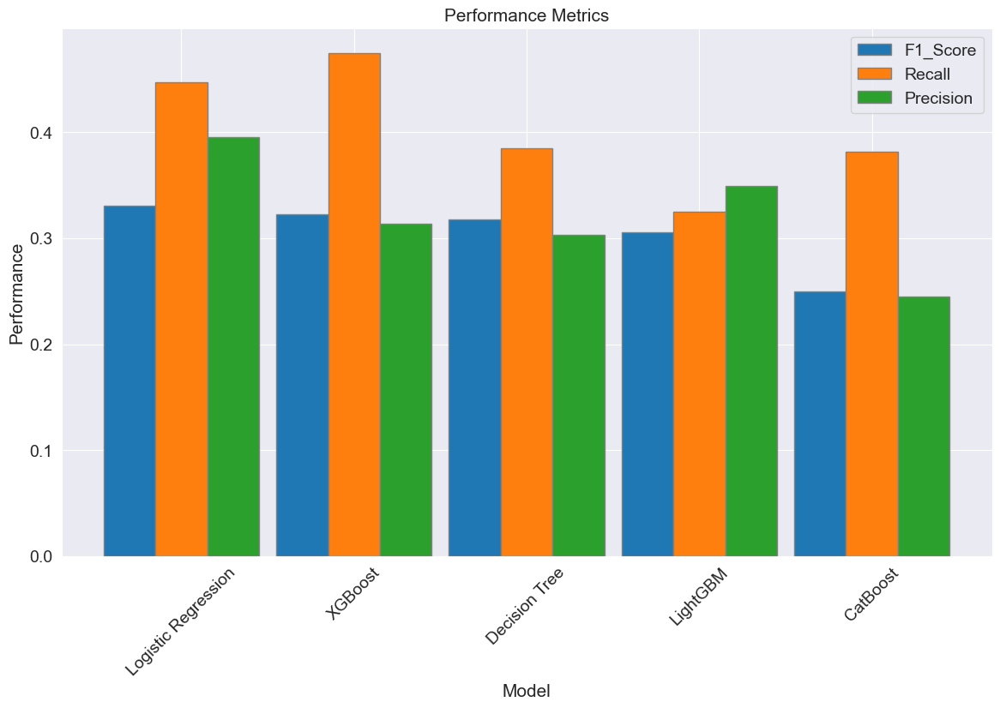

In [432]:
plt.figure(figsize=(14, 8))

barWidth = 0.3

r1 = np.arange(len(sorted_results['Model']))
r2 = [x + barWidth for x in r1]
r3 = [x + barWidth for x in r2]

plt.bar(r1, sorted_results['F1_Score'], width=barWidth, edgecolor='grey', label='F1_Score')
plt.bar(r2, sorted_results['Recall'], width=barWidth, edgecolor='grey', label='Recall')
plt.bar(r3, sorted_results['Precision'], width=barWidth, edgecolor='grey', label='Precision')

plt.xlabel('Model', fontsize=15)
plt.ylabel('Performance', fontsize=15)
plt.title('Performance Metrics', fontsize=15)
plt.xticks([r + barWidth for r in range(len(sorted_results['Model']))], sorted_results['Model'], rotation=45)

plt.legend()

plt.show()

## 6. Применение модели на las-файлах

In [123]:
from cegal.welltools.wells import Well

In [156]:
force_well = Well(filename='./25_2-14.las', path=None)

FileNotFoundError: [WinError 2] Не удается найти указанный файл: './25_2-14.las'

In [154]:
pd.DataFrame(force_well.df())

,FORCE_2020_LITHOFACIES_CONFIDENCE,FORCE_2020_LITHOFACIES_LITHOLOGY,CALI,BS,DCAL,ROP,RDEP,RSHA,RMED,RMIC,...,NPHI,PEF,GR,RHOB,DRHO,SGR,DEPTH_MD,X_LOC,Y_LOC,Z_LOC
DEPT,,,,,,,,,,,,,,,,,,,,,
103.0224,NaN,NaN,NaN,36.000000,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
103.1744,NaN,NaN,NaN,36.000000,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
103.3264,NaN,NaN,NaN,36.000000,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
103.4784,NaN,NaN,NaN,36.000000,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
103.6304,NaN,NaN,NaN,36.000000,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2732.4704,NaN,NaN,NaN,12.250001,-0.531900,NaN,NaN,NaN,NaN,NaN,...,NaN,3.4532,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2732.6224,NaN,NaN,NaN,12.250001,-0.531900,NaN,NaN,NaN,NaN,NaN,...,NaN,3.4532,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2732.7744,NaN,NaN,NaN,12.250001,-0.531900,NaN,NaN,NaN,NaN,NaN,...,NaN,3.4532,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [155]:
test_well = pd.DataFrame(force_well.df())

In [127]:
# Преобразуйте их с помощью scaler.transform
test_well[features] = scaler.transform(test_well[features])

In [8]:
features

NameError: name 'features' is not defined

In [135]:
features = ['DEPTH_MD',
 'CALI',
 'RSHA',
 'RMED',
 'RDEP',
 'RHOB',
 'GR',
 'PEF',
 'DTC',
 'BS',
 'NPHI',
 'SP']

In [136]:
# Загрузка модели из файла
model_path = './catboost_model.pkl'
catboost_model = joblib.load(model_path)

In [128]:
CB_test_well = catboost_model.predict(test_well[features])

In [130]:
# Предсказание классов и вероятностей
predicted_classes = catboost_model.predict(test_well[features])
probabilities = catboost_model.predict_proba(test_well[features])

# Добавление предсказанных классов в DataFrame
test_well['Predicted_Class'] = predicted_classes


In [131]:
test_well['Encoded_Class'] = test_well['Predicted_Class'].map(lithology_keys).map(lithology_numbers)

In [141]:
test_well.isna()

,FORCE_2020_LITHOFACIES_CONFIDENCE,FORCE_2020_LITHOFACIES_LITHOLOGY,CALI,BS,DCAL,ROP,RDEP,RSHA,RMED,RMIC,...,GR,RHOB,DRHO,SGR,DEPTH_MD,X_LOC,Y_LOC,Z_LOC,Predicted_Class,Encoded_Class
DEPT,,,,,,,,,,,,,,,,,,,,,
103.0224,True,True,True,False,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,False,False
103.1744,True,True,True,False,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,False,False
103.3264,True,True,True,False,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,False,False
103.4784,True,True,True,False,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,False,False
103.6304,True,True,True,False,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2732.4704,True,True,True,False,False,True,True,True,True,True,...,True,True,True,True,True,True,True,True,False,False
2732.6224,True,True,True,False,False,True,True,True,True,True,...,True,True,True,True,True,True,True,True,False,False
2732.7744,True,True,True,False,False,True,True,True,True,True,...,True,True,True,True,True,True,True,True,False,False


In [132]:
test_well['Litology'] = CB_test_well

In [23]:
test_well.set_index('DEPTH_MD', inplace=True)

In [133]:
# Примерные цвета для каждой литологии
lithology_colors = {
    0: '#e6e208',  # Sandstone
    1: '#f2f21d',  # Sandstone/Shale
    2: '#0b8102',  # Shale
    3: '#bb4cd0',  # Marl
    4: '#f75f00',  # Dolomite
    5: '#ff7f0e',  # Limestone
    6: '#1f77b4',  # Chalk
    7: '#ff00ff',  # Halite
    8: '#9467bd',  # Anhydrite
    9: '#d62728',  # Tuff
    10: '#8c564b',  # Coal
    11: '#7f7f7f'  # Basement
}

# Создание словаря литологий с названиями и цветами
lithology_description = {v: (k, lithology_colors[i]) for i, (k, v) in enumerate(lithology_keys.items())}


In [134]:
lithology_description
lithology_description = LithologyDescription(lithology_description)

NameError: name 'LithologyDescription' is not defined

In [142]:
lithology_description.dictionary

{0: ('Sandstone', '#e6e208'),
 1: ('Sandstone/Shale', '#f2f21d'),
 2: ('Shale', '#0b8102'),
 3: ('Marl', '#bb4cd0'),
 4: ('Dolomite', '#f75f00'),
 5: ('Limestone', '#ff7f0e'),
 6: ('Chalk', '#1f77b4'),
 7: ('Halite', '#ff00ff'),
 8: ('Anhydrite', '#9467bd'),
 9: ('Tuff', '#d62728'),
 10: ('Coal', '#8c564b'),
 11: ('Basement', '#7f7f7f')}

In [138]:
from cegal.welltools.plotting import CegalWellPlotter as cwp

In [52]:
cwp.plot_logs(df=test_well, 
              logs=['CALI', 'RSHA', 'RMED', 'RDEP', 'RHOB'], 
              log_scale_logs=['RMED', 'RDEP'],
              show_fig=False)

In [135]:
class LithologyDescription:
    def __init__(self, lithology_dict):
        self.dictionary = lithology_dict

# Создание словаря литологий с названиями и цветами
lithology_description_dict = {lithology_numbers[v]: (k, lithology_colors[lithology_numbers[v]]) for k, v in lithology_keys.items()}
lithology_description = LithologyDescription(lithology_description_dict)

In [145]:
test_well.columns

Index(['FORCE_2020_LITHOFACIES_CONFIDENCE', 'FORCE_2020_LITHOFACIES_LITHOLOGY',
       'CALI', 'BS', 'DCAL', 'ROP', 'RDEP', 'RSHA', 'RMED', 'RMIC', 'SP',
       'DTS', 'DTC', 'NPHI', 'PEF', 'GR', 'RHOB', 'DRHO', 'SGR', 'DEPTH_MD',
       'X_LOC', 'Y_LOC', 'Z_LOC', 'Predicted_Class', 'Encoded_Class',
       'Litology'],
      dtype='object')

In [136]:
lithology_description.dictionary

{0: ('Sandstone', '#e6e208'),
 1: ('Sandstone/Shale', '#f2f21d'),
 2: ('Shale', '#0b8102'),
 3: ('Marl', '#bb4cd0'),
 4: ('Dolomite', '#f75f00'),
 5: ('Limestone', '#ff7f0e'),
 6: ('Chalk', '#1f77b4'),
 7: ('Halite', '#ff00ff'),
 8: ('Anhydrite', '#9467bd'),
 9: ('Tuff', '#d62728'),
 10: ('Coal', '#8c564b'),
 11: ('Basement', '#7f7f7f')}

In [55]:
test_well['Encoded_Class'].unique()

array([0, 2, 5], dtype=int64)

In [99]:
lithology_description.dictionary

{0: ('Sandstone', '#e6e208'),
 1: ('Sandstone/Shale', '#f2f21d'),
 2: ('Shale', '#0b8102'),
 3: ('Marl', '#bb4cd0'),
 4: ('Dolomite', '#f75f00'),
 5: ('Limestone', '#ff7f0e'),
 6: ('Chalk', '#1f77b4'),
 7: ('Halite', '#ff00ff'),
 8: ('Anhydrite', '#9467bd'),
 9: ('Tuff', '#d62728'),
 10: ('Coal', '#8c564b'),
 11: ('Basement', '#7f7f7f')}

In [142]:

# Создание словарей литологий и цветов
lithology_numbers = {
    30000: 0,
    65030: 1,
    65000: 2,
    80000: 3,
    74000: 4,
    70000: 5,
    70032: 6,
    88000: 7,
    86000: 8,
    99000: 9,
    90000: 10,
    93000: 11
}

lithology_keys = {
    'Sandstone': 30000,
    'Sandstone/Shale': 65030,
    'Shale': 65000,
    'Marl': 80000,
    'Dolomite': 74000,
    'Limestone': 70000,
    'Chalk': 70032,
    'Halite': 88000,
    'Anhydrite': 86000,
    'Tuff': 99000,
    'Coal': 90000,
    'Basement': 93000
}

# Примерные цвета для каждой литологии
lithology_colors = {0: '#e6e208',
 1: '#f2f21d',
 2: '#0b8102',
 3: '#bb4cd0',
 4: '#f75f00',
 5: '#ff7f0e',
 6: '#1f77b4',
 7: '#ff00ff',
 8: '#9467bd',
 9: '#d62728',
 10: '#8c564b',
 11: '#7f7f7f'}

# Создание класса-обертки для литологий
class LithologyDescription:
    def __init__(self, lithology_dict):
        self.dictionary = lithology_dict

# Создание словаря литологий с названиями и цветами
lithology_description_dict = {lithology_numbers[v]: (k, lithology_colors[lithology_numbers[v]]) for k, v in lithology_keys.items()}
lithology_description = LithologyDescription(lithology_description_dict)


In [88]:
test_well['Encoded_Class'].unique()

array([0, 2, 5], dtype=int64)

In [139]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import numpy as np

# Генерация исходного графика (замените это вызовом вашей функции)
fig = cwp.plot_logs(
    df=test_well,
    logs=['CALI', 'RSHA', 'RMED', 'RDEP', 'RHOB'],
    log_scale_logs=['RMED', 'RDEP'],
    lithology_logs=['Encoded_Class'],
    lithology_description=lithology_description,
    show_fig=False
)

import re


In [207]:
lithology_description.dictionary

{1: ('sand', '#e6e208'), 2: ('shale', '#0b8102'), 5: ('lst', 'Orange')}

In [208]:
lithology_colors

{0: '#e6e208',
 1: '#f2f21d',
 2: '#0b8102',
 3: '#bb4cd0',
 4: '#f75f00',
 5: '#ff7f0e',
 6: '#1f77b4',
 7: '#ff00ff',
 8: '#9467bd',
 9: '#d62728',
 10: '#8c564b',
 11: '#7f7f7f'}

In [209]:
lithology_names

['Sandstone',
 'Sandstone/Shale',
 'Shale',
 'Marl',
 'Dolomite',
 'Limestone',
 'Chalk',
 'Halite',
 'Anhydrite',
 'Tuff',
 'Coal',
 'Basement']

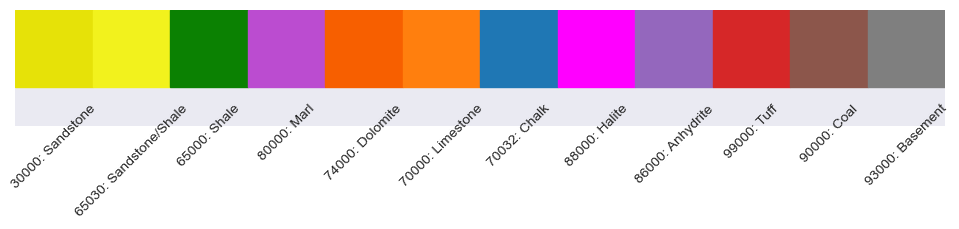

In [140]:
import matplotlib.pyplot as plt

# Литологическое описание
lithology_description = {
 30000: ('Sandstone', '#e6e208'),
 65030: ('Sandstone/Shale', '#f2f21d'),
 65000: ('Shale', '#0b8102'),
 80000: ('Marl', '#bb4cd0'),
 74000: ('Dolomite', '#f75f00'),
 70000: ('Limestone', '#ff7f0e'),
 70032: ('Chalk', '#1f77b4'),
 88000: ('Halite', '#ff00ff'),
 86000: ('Anhydrite', '#9467bd'),
 99000: ('Tuff', '#d62728'),
 90000: ('Coal', '#8c564b'),
 93000: ('Basement', '#7f7f7f')
}

# Генерация данных для графика
numbers = list(lithology_description.keys())
names = [lithology_description[val][0] for val in numbers]
colors = [lithology_description[val][1] for val in numbers]

# Создание фигуры и осей
fig, ax = plt.subplots(figsize=(12, 3))

# Добавление цветных прямоугольников с подписями
for i, (num, name, color) in enumerate(zip(numbers, names, colors)):
    ax.add_patch(plt.Rectangle((i, 0), 1, 1, color=color))
    ax.text(i + 0.5, -0.2, f'{num}: {name}', ha='center', va='top', rotation=45, fontsize=10)

# Настройка осей
ax.set_xlim(0, len(numbers))
ax.set_ylim(-0.5, 1)
ax.set_xticks([])
ax.set_yticks([])
ax.set_aspect('equal')

# Убираем рамку вокруг графика
for spine in ax.spines.values():
    spine.set_visible(False)

# Показать график
plt.show()


In [67]:
lithology_description.dictionary

{0: ('Sandstone', '#e6e208'),
 1: ('Sandstone/Shale', '#f2f21d'),
 2: ('Shale', '#0b8102'),
 3: ('Marl', '#bb4cd0'),
 4: ('Dolomite', '#f75f00'),
 5: ('Limestone', '#ff7f0e'),
 6: ('Chalk', '#1f77b4'),
 7: ('Halite', '#ff00ff'),
 8: ('Anhydrite', '#9467bd'),
 9: ('Tuff', '#d62728'),
 10: ('Coal', '#8c564b'),
 11: ('Basement', '#7f7f7f')}

In [143]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import numpy as np

# Генерация исходного графика (замените это вызовом вашей функции)
fig = cwp.plot_logs(
    df=test_well,
    logs=['CALI', 'RSHA', 'RMED', 'RDEP', 'RHOB'],
    log_scale_logs=['RMED', 'RDEP'],
    lithology_logs=['Encoded_Class'],
    lithology_description=lithology_description,
    show_fig=False
)

import re


In [ ]:
    fig_with_legend.update_layout(
        width=current_width + 150,
        height=720,
        title_text=f"Скважина {well_name}",
        title_x=0.5
    )

In [144]:
# Убираем легенду каротажных кривых
fig.update_layout(showlegend=False)

# Получаем количество колонок из меток осей x
x_axes = [ax for ax in fig.layout if re.match(r'xaxis\d*', ax)]
num_cols = len(x_axes)

# Создаем новую фигуру с дополнительной колонкой для легенды
fig_with_legend = make_subplots(
    rows=1,
    cols=num_cols + 1,  # Увеличиваем количество колонок на 1
    shared_yaxes=True,
    subplot_titles=[*[fig.layout.annotations[i].text for i in range(len(fig.layout.annotations))], "Facies Colors"]
)

# Копируем существующие трейсы в новую фигуру
for trace in fig.data:
    col = int(re.search(r'\d+', trace.xaxis).group()) if re.search(r'\d+', trace.xaxis) else 1
    fig_with_legend.add_trace(trace, row=1, col=col)

# Генерация данных для легенды литологии
lithology_values = list(lithology_description.dictionary.keys())
lithology_names = [lithology_description.dictionary[val][0] for val in lithology_values]
lithology_colors = [lithology_description.dictionary[val][1] for val in lithology_values]

# Создаем Heatmap для легенды литологии
fig_with_legend.add_trace(
    go.Heatmap(
        z=np.array(lithology_values).reshape(len(lithology_values), 1),  # Преобразуем значения литологии в 2D массив
        x=['Facies Colors'],  # Используем подпись для нового столбца
        y=lithology_names,
        colorscale=list(zip(np.linspace(0, 1, len(lithology_colors)), lithology_colors)),
        showscale=False,  # Отключаем цветовую шкалу
        hoverinfo='y',
        hovertemplate="<b>Lithology</b>: %{y}<extra></extra>"
    ),
    row=1,
    col=num_cols + 1  # Добавляем в новую последнюю колонку
)

# Проверка и обновление ширины
current_width = fig.layout.width if fig.layout.width is not None else 700  # Задаем значение по умолчанию, если None

# Обновляем макет
fig_with_legend.update_layout(
    height=fig.layout.height,
    width=current_width + 200,  # Увеличиваем ширину для новой колонки
    title='',  # Убираем заголовок
    yaxis=dict(autorange='reversed')  # Инвертируем ось Y
)

# Поворачиваем названия колонок на 45 градусов
for annotation in fig_with_legend.layout.annotations:
    annotation['textangle'] = 45

# Показываем новую фигуру
fig_with_legend.show()

In [162]:
lithology_description.dictionary

{0: ('Sandstone', '#e6e208'),
 1: ('Sandstone/Shale', '#f2f21d'),
 2: ('Shale', '#0b8102'),
 3: ('Marl', '#bb4cd0'),
 4: ('Dolomite', '#f75f00'),
 5: ('Limestone', '#ff7f0e'),
 6: ('Chalk', '#1f77b4'),
 7: ('Halite', '#ff00ff'),
 8: ('Anhydrite', '#9467bd'),
 9: ('Tuff', '#d62728'),
 10: ('Coal', '#8c564b'),
 11: ('Basement', '#7f7f7f')}

In [78]:
# Литологическое описание
lithology_description = {
    0: ('Sandstone', '#e6e208'),
    1: ('Sandstone/Shale', '#f2f21d'),
    2: ('Shale', '#f75f00'),
    3: ('Marl', '#bb4cd0'),
    4: ('Dolomite', '#0b8102'),
    5: ('Limestone', '#ff7f0e'),
    6: ('Chalk', '#1f77b4'),
    7: ('Halite', '#ff00ff'),
    8: ('Anhydrite', '#9467bd'),
    9: ('Tuff', '#d62728'),
    10: ('Coal', '#8c564b'),
    11: ('Basement', '#7f7f7f')
}

In [171]:
test_well['Predicted_Class'].value_counts()

Shale        10453
Sandstone     6821
Limestone       30
Name: Predicted_Class, dtype: int64

In [175]:
test_well['Predicted_Class']

DEPT
103.0224     Sandstone
103.1744     Sandstone
103.3264     Sandstone
103.4784     Sandstone
103.6304     Sandstone
               ...    
2732.4704    Sandstone
2732.6224    Sandstone
2732.7744    Sandstone
2732.9264    Sandstone
2733.0784    Sandstone
Name: Predicted_Class, Length: 17304, dtype: object

In [176]:
test_well[['Predicted_Class'] ][test_well['Predicted_Class'] == 'Limestone']

,Predicted_Class
DEPT,
2699.6384,Limestone
2699.7904,Limestone
2699.9424,Limestone
2700.0944,Limestone
2700.2464,Limestone
2700.3984,Limestone
2700.5504,Limestone
2700.7024,Limestone
2700.8544,Limestone
